In [ ]:
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)

In [1]:
import graphviz

In [2]:
#Instantiate a graph
dot = graphviz.Digraph('round-table', comment='The Round Table')
#add some nodes
dot.node('A', 'King Arthur')
dot.node('B', 'Sir Bedevere the Wise')
dot.node('L', 'Sir Lancelot the Brave')
#add some edges
dot.edges(['AB', 'AL'])
dot.edge('B', 'L', constraint='false')

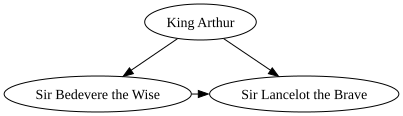

In [3]:
dot

In [4]:
import spacy
import re
from requests import get
from ast import literal_eval
import ast
import json
import string
from pprint import pprint

In [5]:
import pandas as pd
import numpy as np
import pickle
import pandas_read_xml as pdx
from pandas_read_xml import flatten, fully_flatten, auto_separate_tables

In [6]:
SEED = 42

# before training/inference:
np.random.seed(SEED)

In [7]:
from fuzzywuzzy import fuzz
from fuzzywuzzy import process

In [8]:
from sklearn.feature_extraction import text
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from wordcloud import WordCloud

In [9]:
import pyLDAvis
import gensim
import pyLDAvis.gensim_models
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from gensim import matutils, models
import scipy.sparse
import nltk
from nltk import word_tokenize, pos_tag

In [45]:
dir(gensim.models) #lda_model.log_perplexity(corpus)

['AtireBM25Model',
 'AuthorTopicModel',
 'BackMappingTranslationMatrix',
 'CoherenceModel',
 'Doc2Vec',
 'EnsembleLda',
 'FAST_VERSION',
 'FastText',
 'HdpModel',
 'KeyedVectors',
 'LdaModel',
 'LdaMulticore',
 'LdaSeqModel',
 'LogEntropyModel',
 'LsiModel',
 'LuceneBM25Model',
 'Nmf',
 'NormModel',
 'OkapiBM25Model',
 'Phrases',
 'RpModel',
 'TfidfModel',
 'TranslationMatrix',
 'VocabTransform',
 'Word2Vec',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '_fasttext_bin',
 'atmodel',
 'basemodel',
 'bm25model',
 'callbacks',
 'coherencemodel',
 'doc2vec',
 'doc2vec_corpusfile',
 'doc2vec_inner',
 'ensemblelda',
 'fasttext',
 'fasttext_corpusfile',
 'fasttext_inner',
 'hdpmodel',
 'interfaces',
 'keyedvectors',
 'ldamodel',
 'ldamulticore',
 'ldaseqmodel',
 'logentropy_model',
 'lsimodel',
 'nmf',
 'nmf_pgd',
 'normmodel',
 'phrases',
 'rpmodel',
 'tfidfmodel',
 'translation_matrix',
 'utils',
 'word2vec',


In [10]:
#nltk.download('punkt')
#nltk.download('averaged_perceptron_tagger')

In [11]:
#import pyLDAvis
#import pyLDAvis.gensim  
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
%matplotlib inline

In [12]:
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

## THREE DATA SOURCES
###### 1. MENDELAY ABSTRACT AND ARTICLE INFORMATION
###### 2. REFERENCE AND CITATION LIST FROM opencitations
###### 3. Extracted PDF Text Body

In [13]:
WILEY = pd.read_pickle('WILEY.pkl')# ['PAGE1'][0]
ELSEVIER = pd.read_pickle('ELSEVIER.pkl')
TAYLOR = pd.read_pickle('TAYLOR.pkl')
EMERALD = pd.read_pickle('EMERALD.pkl')
SAGE = pd.read_pickle('SAGE.pkl')
SPRINGER = pd.read_pickle('SPRINGER.pkl')
OTHERS = pd.read_pickle('OTHERS.pkl')
#with open('output2.pickle', 'rb') as f:
#    data = pickle.load(f)
#    print(data[0])

In [14]:
WILEY["IM_FROM"] = "WILEY"
ELSEVIER["IM_FROM"] = "ELSEVIER"
TAYLOR["IM_FROM"] = "TAYLOR"
EMERALD["IM_FROM"] = "EMERALD"
SAGE["IM_FROM"] = "SAGE"
SPRINGER["IM_FROM"] = "SPRINGER"
OTHERS["IM_FROM"] = "OTHERS"

In [15]:
CORPUS_TOTAL = pd.concat([WILEY,ELSEVIER,TAYLOR,EMERALD,SAGE, SPRINGER, 
                          OTHERS], ignore_index=True, sort=False)

In [18]:
AFRICA = pd.read_pickle('AFRICA_127.pkl')

In [14]:
METADATA3_AFRICA = pd.read_pickle('METADATA3_AFRICA.pkl')

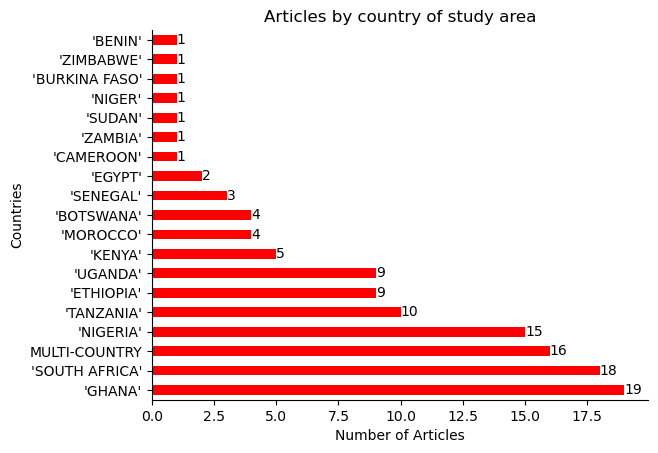

In [21]:
AFRICA.columns
AFRICA['xml|records|record|urls|related-urls'] = AFRICA[
    'xml|records|record|urls|related-urls'].astype(
    'string').str.strip(r'[\[\]\{\}\]').str[7:].str.strip(r'\[')
AFRICA.replace({'xml|records|record|urls|related-urls' : 
                { "'IMMIGRANT'" : 'MULTI-COUNTRY', "'DEVELOPING COUNTRIES'" : 'MULTI-COUNTRY', 
                 "'AFRICA'" : 'MULTI-COUNTRY' }}, inplace=True)
ax = AFRICA[AFRICA['xml|records|record|dates|year']!='2024']['xml|records|record|urls|related-urls'].value_counts(
).plot(kind='barh',title='Articles by country of study area',xlabel='Number of Articles',
                    ylabel='Countries',color='r')
for c in ax.containers:
    # set the bar label
    ax.bar_label(c, fmt='%.0f', label_type='edge')

#ax.legend(title='count per journal', bbox_to_anchor=(1, 1.02), loc='upper left')

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.show()

In [18]:
source_col_loc = CORPUS_TOTAL.columns.get_loc('PAGE1')
CORPUS_TOTAL.loc[:,'ABSTRACT'] = CORPUS_TOTAL['PAGE1']
CORPUS_TOTAL['COMBINED_BODEY'] = CORPUS_TOTAL.iloc[:,source_col_loc:source_col_loc+68].apply(
    lambda x: " ABELPAGE ".join(x.astype(str).fillna('')), axis=1)
CORPUS_TOTAL.drop(CORPUS_TOTAL.iloc[:,0:68], inplace=True, axis=1)

In [ ]:
AFRICA[120:129]
Bujra = open('bujra1975.txt', "r",newline='').read()
Mahadea = open('Mahadea2001.txt', "r",newline='').read()
Schutte = open('Schutte2001.txt', "r",newline='').read()
AFRICA.at[120,'MATCH'] = Bujra
AFRICA.at[123, 'MATCH'] = Mahadea
AFRICA.at[128, 'MATCH'] = Schutte
    # Read the text in the file

In [250]:
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use','also'])

In [ ]:
#file_path22 = "D:/PUBLICATIONS/GENDER AND ENTREPRENEURSHIP/MERGED_FOR_ONETIMEUSE/MENDLAY_AFRICA.xml"
file_path22 = "D:/PUBLICATIONS/GENDER AND ENTREPRENEURSHIP/MERGED_FOR_ONETIMEUSE/MENDLAY_AFRICA2.xml"
with open(file_path22, "r", encoding='utf8') as f:
    AFRICA = pdx.read_xml(f.read())
AFRICA
#df = pdx.read_xml(test_xml,['<b:Source>'])
AFRICA
AFRICA = AFRICA.pipe(flatten)
AFRICA = AFRICA.pipe(flatten)
AFRICA = AFRICA.pipe(flatten)
AFRICA = AFRICA.pipe(flatten)
AFRICA = AFRICA.pipe(flatten)
#df = df.pipe(flatten)
#df = df.pipe(flatten)
AFRICA['CLEAN_AUTHOR'] = AFRICA['xml|records|record|contributors|authors'].astype('string').str.strip(r'[\[\]\{\}\]').str[10:].str.strip(r'\[')
AFRICA['COUNTRY_STUDY'] = AFRICA['xml|records|record|urls|related-urls'].astype('string').str.strip(r'[\[\]\{\}\]').str[7:].str.strip(r'\[')
AFRICA.loc[:,'MATCH'] = AFRICA['xml|records|record|abstract'].astype(str).apply(lambda x:[process.extract(x, CORPUS_TOTAL.COMBINED_BODEY, limit=1,scorer=fuzz.token_set_ratio)][0][0][0])
#AFRICA.rename(columns={"matchesALL": "REAL_DOI"},inplace=True)
#AFRICA = pd.merge(AFRICA, EMRGED_FINAL[['PAGE1','PAGE2','CLEAN_BODY','FIRST_AUTHOR','REAL_DOI']], on='REAL_DOI')
#AFRICA[AFRICA.duplicated(subset=['matchesALL'], keep=False) == True]

In [191]:
AFRICA['MATCH'][123]
AFRICA[120:129]
AFRICA.to_pickle('AFRICA_127.pkl')

In [16]:
METADATA3_AFRICA.to_pickle('METADATA3_AFRICA.pkl')

In [ ]:
128,123 Mahadea,120 Bujra

In [19]:
to_remove = ['https://doi.org/', 'DOI: ','/Published']
p = re.compile('|'.join(map(re.escape, to_remove))) # escape to handle metachars
AFRICA["DOI_REAL"] = [p.sub('', s) for s in AFRICA['xml|records|record|electronic-resource-num'].astype(str)]

In [15]:
API_CALL = "https://opencitations.net/index/coci/api/v1/citations/10.1016/S0883-9026(96)00061-4"
#API_CALL = "https://opencitations.net/index/coci/api/v1/metadata/f'{XX}"
HTTP_HEADERS = {"authorization": "d7ba5b3c-e211-413c-aa4a-7f7e32ecf1ae"}
#XXXX11.reset_index()
#XXXX11[XXXX11['DOI_REAL'].isin(AFRICA['REAL_DOI'])]
DFAFRICA_FOR_URL = AFRICA[~(AFRICA['REAL_DOI']=='nan')]
#XX = '__'.join(DF_FOR_URL.REAL_DOI.astype(str).to_list())
url = 'https://opencitations.net/index/coci/api/v1/metadata/{paramA}'
all_data = []
for paramA in DFAFRICA_FOR_URL["REAL_DOI"].astype(str):
    u = url.format(paramA=paramA)
    data = get(u, headers=HTTP_HEADERS, verify=False).json()
    all_data.append(data)   # <-- or add to `all_data` only information you want from the response
    print(u)
METADATA3_AFRICA = pd.DataFrame(all_data)

D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/01409171111102821


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/03068290410515439


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/17542411011019904


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/17542411111130972


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/20400701111110795


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/20400701111165641


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/AJEMS-05-2021-0223


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/AJEMS-08-2021-0354


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/AJEMS-10-2012-0067


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/AJEMS-10-2013-0090


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/EDI-10-2017-0230


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/GM-01-2017-0003


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/GM-01-2020-0019


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/GM-02-2014-0018


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/GM-05-2013-0054


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/GM-07-2016-0141


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/GM-08-2019-0141


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJEBR-05-2021-0402


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-01-2019-0018


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-01-2021-0013


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-02-2018-0010


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-02-2022-0021


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-06-2021-0096


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-07-2021-0109


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-08-2021-0142


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-12-2018-0138


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJOA-08-2020-2387


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JEC-01-2020-0010


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-06-2021-0085


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JEC-12-2020-0207


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JEEE-07-2018-0070


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JEEE-11-2019-0174


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JEPP-09-2020-0073


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JIEB-12-2019-0058


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JSBED-02-2017-0073


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JSBED-03-2017-0115


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/SEJ-01-2018-0012


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1016/j.wsif.2017.11.013


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1016/j.techfore.2021.121401


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1016/j.jbusres.2023.113962


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1016/j.worlddev.2022.105966


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1016/j.jtrangeo.2016.04.013


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1016/j.jbusvent.2022.106205


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1177/2158244020963131


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1177/0269094219864082


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1177/10422587221077222


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.5367/ihe.2013.0171


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1177/0170840607068256


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1177/1467358414524979


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1177/1464993416688830


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228910802701445


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2012.657937


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/0966369X.2013.802674


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/13215906.2015.1018381


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/23322373.2018.1428019


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/23311932.2020.1863565


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/17530350.2022.2041463


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/08985620802182144


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/08985626.2022.2128897


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/23311975.2020.1818365


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2022.2026099


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228910802701296


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2022.2078937


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/23322373.2015.1062710


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/0376835X.2014.887995


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2022.2053400


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/00083968.2019.1680405


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/00472778.2019.1672707


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/09614524.2023.2178639


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2017.1336915


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/13215906.2020.1769715


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2022.2079871


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/13545701.2021.1943486


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/00291950802335525


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2020.1826859


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/02723638.2013.778640


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2023.2168970


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/21568316.2018.1556329


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/14330237.2021.2018109


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/23311975.2022.2137954


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/00472778.2020.1756121


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/20421338.2021.2003510


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/13691066.2017.1358927


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/13683500.2022.2052267


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228910802701387


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/01436597.2023.2189580


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2021.1874783


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/20421338.2021.1961359


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/0023656X.2020.1851666


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2022.2069434


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/0376835X.2019.1657001


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228916.2015.1081025


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/0966369X.2015.1013444


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/09614524.2018.1526257


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15575330.2023.2173264


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/19186444.2016.1265786


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1007/s11365-005-1129-3


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1177/0002716207303586


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/13215906.2017.1339631


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/ER-07-2020-0332


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/IJGE-12-2015-0048


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JSBED-02-2017-0063


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/10705420802473642


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1007/s13280-012-0355-5


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1108/JSBED-02-2017-0057


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228910802701361


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1002/jid.1782


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1111/gwao.12184


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.4102/hts.v78i2.7987


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.4102/SAJBM.V52I1.2228


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1504/AJAAF.2015.073478


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1504/IJLIC.2016.075693


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1016/j.wsif.2012.06.002


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/13629380108718451


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/09669582.2023.2186827


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/15228910802701270


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/03057070.2010.507576


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/03057070701475278


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/00220388.2016.1184250


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1111/jsbm.12407


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/00083968.1975.10804456


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/09765239.2016.11907818


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.4314/jsr.v21i2.65746


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/037/68350120041893


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1080/03768358908439463


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.4102/sajems.v10i2.577


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.4102/sajbm.v18i3.1012


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.4102/sajems.v21i1.1965


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.4102/sajip.v21i3.594


D:\ANACONDA3\envs\FOR_SPACY\lib\site-packages\urllib3\connectionpool.py:1045: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opencitations.net'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/1.26.x/advanced-usage.html#ssl-warnings
  warnings.warn(


https://opencitations.net/index/coci/api/v1/metadata/10.1142/s0218495810000628


In [21]:
XX_AFRICA = METADATA3_AFRICA[~(METADATA3_AFRICA[0].isna())]
#XX_AFRICA.loc[:,0] = XX_AFRICA[0].apply(ast.literal_eval)

XX_AFRICA.loc[:,['DOI_REAL']] = XX_AFRICA[0].str.get("doi")
XX_AFRICA.loc[:,['CITATION']] = XX_AFRICA[0].str.get("citation")
XX_AFRICA.loc[:,['REFERENCES1']] = XX_AFRICA[0].str.get("reference")
XX_AFRICA.loc[:,['title']] = XX_AFRICA[0].str.get("title")
XX_AFRICA.loc[:,['Author']] = XX_AFRICA[0].str.get("author")
XX_AFRICA.loc[:,['Year']] = XX_AFRICA[0].str.get("year")
XX_AFRICA.loc[:,['Journal']] = XX_AFRICA[0].str.get("source_title")
XX_AFRICA.loc[:,['CITATION_COUNT']] = XX_AFRICA[0].str.get("citation_count")

#explode
XX_AFRICA.loc[:,'REFERENCES1'] = XX_AFRICA['REFERENCES1'].str.split(';') #CITATION
XXXX1_AFRICA = XX_AFRICA.explode('REFERENCES1')
XXXX1_AFRICA
#XX['CITATION'] = XX['CITATION'].str.split(';') #CITATION
#XXXX2 = XX.explode('CITATION')

,0,DOI_REAL,CITATION,REFERENCES1,title,Author,Year,Journal,CITATION_COUNT
0,"{'year': '2011', 'title': 'Challenges Facing W...",10.1108/01409171111102821,10.1007/s11365-015-0379-y; 10.1057/978-1-137-3...,,Challenges Facing Women Entrepreneurs In Nigeria,"Halkias, Daphne; Nwajiuba, Chinedum; Harkiolak...",2011,Management Research Review,65
1,"{'year': '2004', 'title': 'Female Entrepreneur...",10.1108/03068290410515439,10.1007/s11205-015-1203-3; 10.1007/s11365-015-...,10.1787/sme_outlook-1997-en,Female Entrepreneurs In A Transitional Economy,"Woldie, Atsede; Adersua, Adebimpe",2004,International Journal Of Social Economics,63
1,"{'year': '2004', 'title': 'Female Entrepreneur...",10.1108/03068290410515439,10.1007/s11205-015-1203-3; 10.1007/s11365-015-...,10.5367/000000002101299132,Female Entrepreneurs In A Transitional Economy,"Woldie, Atsede; Adersua, Adebimpe",2004,International Journal Of Social Economics,63
1,"{'year': '2004', 'title': 'Female Entrepreneur...",10.1108/03068290410515439,10.1007/s11205-015-1203-3; 10.1007/s11365-015-...,10.3998/mpub.23615,Female Entrepreneurs In A Transitional Economy,"Woldie, Atsede; Adersua, Adebimpe",2004,International Journal Of Social Economics,63
2,"{'year': '2010', 'title': 'The Role Of Cultura...",10.1108/17542411011019904,10.5367/ijei.2012.0071; 10.1007/978-81-322-074...,10.1007/bf00380341,The Role Of Cultural Values In Understanding T...,"Mordi, Chima; Simpson, Ruth, 0000-0002-9917-16...",2010,Gender In Management: An International Journal,63
...,...,...,...,...,...,...,...,...,...
129,"{'year': '2010', 'title': 'Challenges In Femal...",10.1142/s0218495810000628,10.1108/jeee-04-2017-0027; 10.1142/s1084946718...,10.1142/s0218495806000118,Challenges In Female Entrepreneurial Developme...,"Singh, Satwinder; Mordi, Chima; Okafor, Chinon...",2010,Journal Of Enterprising Culture,12
129,"{'year': '2010', 'title': 'Challenges In Femal...",10.1142/s0218495810000628,10.1108/jeee-04-2017-0027; 10.1142/s1084946718...,10.1142/s0218495809000242,Challenges In Female Entrepreneurial Developme...,"Singh, Satwinder; Mordi, Chima; Okafor, Chinon...",2010,Journal Of Enterprising Culture,12
129,"{'year': '2010', 'title': 'Challenges In Femal...",10.1142/s0218495810000628,10.1108/jeee-04-2017-0027; 10.1142/s1084946718...,10.1177/0266242608100488,Challenges In Female Entrepreneurial Developme...,"Singh, Satwinder; Mordi, Chima; Okafor, Chinon...",2010,Journal Of Enterprising Culture,12
129,"{'year': '2010', 'title': 'Challenges In Femal...",10.1142/s0218495810000628,10.1108/jeee-04-2017-0027; 10.1142/s1084946718...,10.1177/104225870202600303,Challenges In Female Entrepreneurial Developme...,"Singh, Satwinder; Mordi, Chima; Okafor, Chinon...",2010,Journal Of Enterprising Culture,12


In [22]:
print(len(CORPUS_TOTAL), len(CORPUS_TOTAL.columns))
print(len(AFRICA), len(AFRICA.columns))
print(len(METADATA3_AFRICA), len(METADATA3_AFRICA.columns))
print(len(XX_AFRICA), len(XX_AFRICA.columns))
print(len(XXXX1_AFRICA), len(XXXX1_AFRICA.columns))
#1052 2
#130 20
#130 1
#118 9
#4297 9

1052 2
130 20
130 1
118 9
4297 9


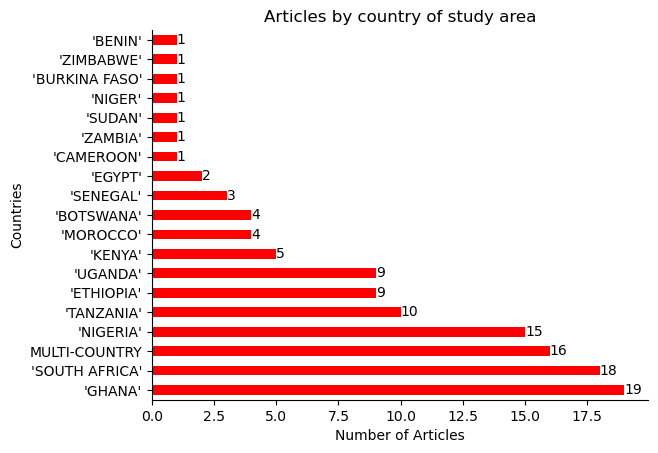

In [24]:
AFRICA.columns
AFRICA['xml|records|record|urls|related-urls'] = AFRICA[
    'xml|records|record|urls|related-urls'].astype(
    'string').str.strip(r'[\[\]\{\}\]').str[7:].str.strip(r'\[')
AFRICA.replace({'xml|records|record|urls|related-urls' : 
                { "'IMMIGRANT'" : 'MULTI-COUNTRY', "'DEVELOPING COUNTRIES'" : 'MULTI-COUNTRY', 
                 "'AFRICA'" : 'MULTI-COUNTRY' }}, inplace=True)
ax = AFRICA[AFRICA['xml|records|record|dates|year']!='2024']['xml|records|record|urls|related-urls'].value_counts(
).plot(kind='barh',title='Articles by country of study area',xlabel='Number of Articles',
                    ylabel='Countries',color='r')
for c in ax.containers:
    # set the bar label
    ax.bar_label(c, fmt='%.0f', label_type='edge')

#ax.legend(title='count per journal', bbox_to_anchor=(1, 1.02), loc='upper left')

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.show()

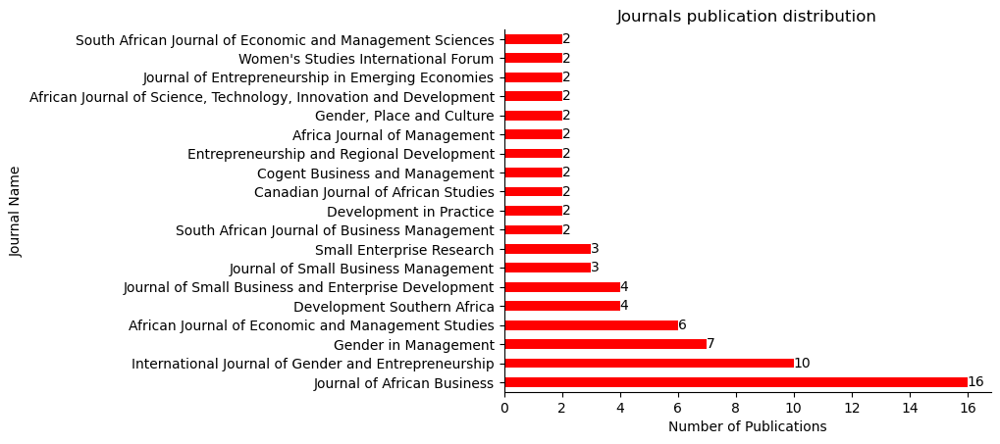

In [25]:
#AFRICA['xml|records|record|periodical|full-title'].value_counts().head(10).plot.bar()
ax = AFRICA[AFRICA['xml|records|record|dates|year']!='2024']['xml|records|record|periodical|full-title'].value_counts(
).head(19).plot(kind='barh',title='Journals publication distribution',xlabel='Number of Publications',
                    ylabel='Journal Name',color='r')
for c in ax.containers:
    # set the bar label
    ax.bar_label(c, fmt='%.0f', label_type='edge')

#ax.legend(title='count per journal', bbox_to_anchor=(1, 1.02), loc='upper left')

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.show()

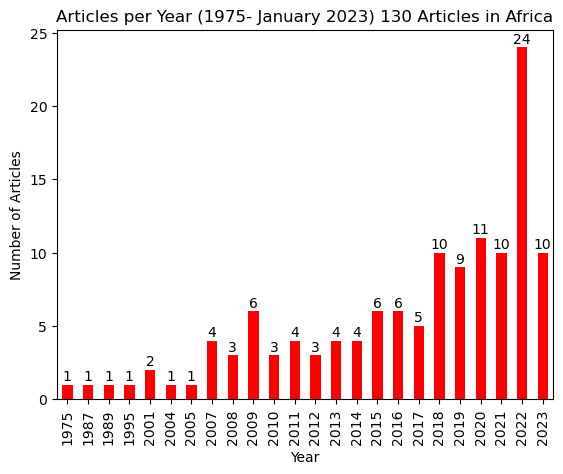

In [23]:
AFRICA.columns
#AFRICA['CLEAN_AUTHOR'].value_counts().head(10).plot.bar()
ax = AFRICA[AFRICA['xml|records|record|dates|year']!='2024']['xml|records|record|dates|year'].value_counts(
).sort_index().plot(kind='bar',title='Articles per Year (1975- January 2023) 130 Articles in Africa',xlabel='Year',
                    ylabel='Number of Articles',color='r') #120
for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
plt.show()

<Axes: title={'center': 'Articles per Year (1975-2022) 130 Articles in Africa'}, xlabel='Year', ylabel='Number of Articles'>

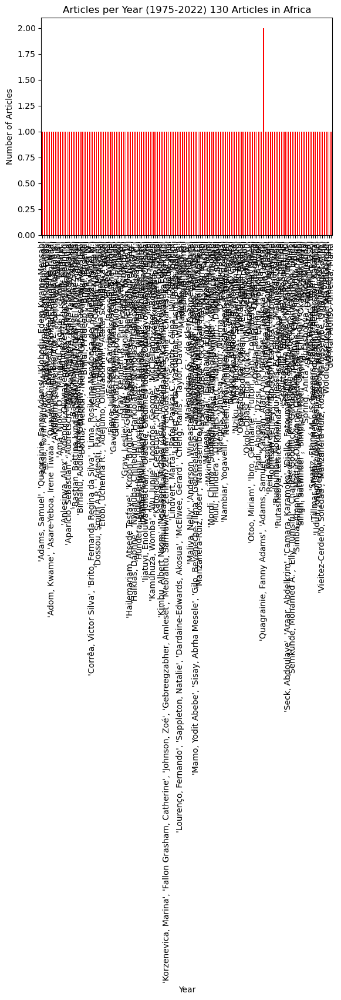

In [22]:
AFRICA['CLEAN_AUTHOR'].value_counts(
).sort_index().plot(kind='bar',title='Articles per Year (1975-2022) 130 Articles in Africa',xlabel='Year',
                    ylabel='Number of Articles',color='r')

In [32]:
AFRICA['xml|records|record|periodical|full-title'].value_counts().tail(60).sort_index()

xml|records|record|periodical|full-title
Africa Journal of Management                                          2
African J. Accounting, Auditing and Finance                           1
African Journal of Science, Technology, Innovation and Development    2
Ambio                                                                 1
Annals of the American Academy of Political and Social Science        1
Cogent Food and Agriculture                                           1
Community Development                                                 1
Current Issues in Tourism                                             1
Employee Relations                                                    1
Entrepreneurship and Regional Development                             2
Entrepreneurship: Theory and Practice                                 1
Equality, Diversity and Inclusion                                     1
Feminist Economics                                                    1
Gender in Management: A

In [225]:
Countries_Af = ['Mauritania','Nigeria','Ghana','Benin','Ethiopia','Uganda','Kenya','Zambia',\
                'Lesotho','Gambia','Burkinafaso','Tanzania','Egypt','Morocco','Algeria','Sudan','Rwanda',\
                'Djibouti','Burundi','Congo','Chad','Cameron','Libya','Mozambique','Senegal','Botswana',\
                'Namibia','Angola','Gabon','Siera leaon','Liberia','Eswatini','Zimbabwe','Malawi',\
                'Ivory cost','Seychelles','Sao Tome','Mauritius','Eritrea','Comoros','Niger',\
                'South Africa','Madagascar','Cape Verd','Central African Repeublic','Equatorial Guinea',\
                'Guinea','Guinea-Bissau','Mali','Togo','Somalia','Tunisia']
from itertools import chain
print(list(chain.from_iterable(zip(Countries_Af, ["OR"]*len(Countries_Af))))[:-1])
print(len(Countries_Af))
print(sorted(Countries_Af))

SyntaxError: invalid syntax. Perhaps you forgot a comma? (646458875.py, line 13)

# CLEANING

In [23]:
to_remove = [' e g ',' et al ',' al,',' et,','et, al','Abstract Purpose','Findings –','Findings: ', 
             'emerald publishing','Purpose –','Purpose: ', 'Design/methodology/approach -', 
             'Originality/value –', 'emerald','publishing','limited','PP','dr','ome','emerald','download','table',
             'cite','Brush',
            'Emerald Group Publishing Limited', 'Research limitations/implications:','Design/methodology/approach:',
            'NONE', ' None ', ' nan nan ']
p = re.compile('|'.join(map(re.escape, to_remove))) # escape to handle metachars
AFRICA.loc[:,"MATCH"] = [p.sub('', s) for s in AFRICA['MATCH'].astype(str)]

In [24]:
def clean_text_round1(text):
    "get ride of some non sesical text"
    text = re.sub('-\n','',text)
    text = re.sub('\n',' ',text)
    text = re.sub('-', '',text)
    text = re.sub('^([A-Za-z]+|19[5-9]\d|20[0-1]\d|202[0-5])',' ', text)
    text = re.sub('(\b(?!(?:18|19|20)\d{2}\b(?!\.\d))\d*\.?\d+\b)',' ', text)
    text = re.sub('[0-9]',' ', text) #get ride of any numbers
    text = re.sub('(\\W+)',' ', text) #get ride of any characters 
    text = re.sub('(https:\/\/.*)',' ', text) #get ride of url and links
    text = re.sub('(http\S+|www.\S+)',' ', text) #get ride of url and links
    text = re.sub('(\([^()\d]*\d\w[^()]*\))',' ', text) #get ride numbers in a bracket
    text = re.sub('[%s]' % re.escape(string.punctuation),'', text) #get ride of punctuations 
    #text = re.sub(r'([a-z]+?)\1+', r'\1', text) #r'\1' #([a-z]+?)\1+ #([a-z])\1+ #[^A-z0-9 ]+
    #text = re.sub('([^A-z0-9 ]+)', '', text) #(?<!\S)(?:(?:[A-Za-z]\.){3,}|[A-Z]{3,})(?!\S)
    text = re.sub('(References|NOTES|Notes|REFERENCES)\s+', '', text) 
    text = re.sub('((?<!\S)(?:(?:[A-Za-z]\.){3,}|[A-Z]{3,})(?!\S))', '', text) 
    return text
round1 = lambda x: clean_text_round1(x)

In [25]:
#df['Name'] = df.Name.str[:2]
AFRICA['MATCH'] = AFRICA['MATCH'].str.split(
    n=-1,
    pat=r'(References|NOTES|Notes|REFERENCES|Appendix|Ghana   Aidis R By law|AchoChi C The mobile street food service\
    |    IN     Ahl H The Scientific Reproduction of Gender|Entrepreneurial Outcomes   Aldrich H Elam A Reese P\
    | Bloom D E Sachs J D Collier P Udry C| Abam F I and G O Unachukwu Vehicular\
    | Adler N Competitive frontiers women managers |http   ﬁethiopia org Rah File MFIs Outreach\
    |OF      is a US based research institute|Alila and Pedersen Clark Daniels Fisseha Horn\
    |P   School of Sociology and Criminology| Agholor DE Adu EO Seriki II An\
    |R Entrepreneurship as a career option for|manufacturing and services for J Enterprising Culture Downloaded)',
                               regex=True, expand=True)[0]
#5,8,9,11,13,17  #references #50,51,75,84,85,102,103,105,106.113,115,116,120,121,123,124,128,129  74
#AFRICA['MATCH'].str.replace('(?i)\s*\b(References|Notes|Appendix).*','')[0]
#AFRICA['MATCH'].str.replace('^.*?(?=References).*', '',regex=True)
#AFRICA['MATCH'].str.rsplit(n=-1,pat=r'(?i)\s*\b(References|Notes|Appendix).*',
#                               expand=True)[0][0]
#AFRICA['MATCH'][3] #C C C C C #Copyright John Wiley Sons Ltd 120 123\n

In [26]:
AFRICA['TEXT_BODY'] = pd.DataFrame(AFRICA.MATCH.apply(round1))

In [27]:
AFRICA['TEXT_BODY'] = AFRICA['TEXT_BODY'].str[305:]

# Tokenize words and Clean-up text

In [28]:
data_AFRICA = AFRICA.TEXT_BODY.values.tolist()

In [29]:
AFRICA_NLTK = AFRICA.copy()
AFRICA_NLTK['Name'] = AFRICA_NLTK[
    'xml|records|record|dates|year'].astype(str).str.cat(AFRICA_NLTK['CLEAN_AUTHOR'].str[:20], sep=' ')
AFRICA_NLTK = AFRICA_NLTK.set_index('Name')

# Define functions for TOKENIZATION, stopwords, bigrams, trigrams and lemmatization
#TOKENIZATION
def sent_to_words(sentences):
    result = []
    for sentence in gensim.utils.simple_preprocess(str(sentences), deacc=True):
        if len(sentence) > 2:
        #if sentence not in gensim.parsing.preprocessing.STOPWORDS and len(sentence) > 2:
            result.append(sentence)
    return result
AFRICA_NLTK['tokenized'] = AFRICA_NLTK['TEXT_BODY'].map(sent_to_words)
AFRICA_NLTK['tokenized'][0]

#REMOVE STOPWORDS
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use','also','business','entrepreneur',
                   'woman', 'entrepreneurs', 'women','P','S','C','faseke','cent','percent','turkish',
                   #'nigeria','nigerian','ethiopia','cameroon',
                   'female','men','th','oman','dr','download','research','co',
                   'ghana','entrepreneurial','study','vol','ngozi','calli','gendere','gender',
                   'ome','ﬀect','okello','cogent'])
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]
AFRICA_NLTK['nostop_words'] = AFRICA_NLTK['tokenized'].map(lambda x: remove_stopwords([x]))
AFRICA_NLTK['nostop_words'][0][0]
#CREATING BIGRAMS WITH 100 THRESHOLD
def bigrams(text):
    bigram = gensim.models.Phrases(text[0], min_count=5, threshold=100,delimiter='_')
    bigram_mod = gensim.models.phrases.Phraser(bigram)
    return [bigram_mod[doc] for doc in text[0]]
AFRICA_NLTK['bigrams'] = AFRICA_NLTK['nostop_words'].map(lambda x: bigrams([x]))
AFRICA_NLTK['bigrams'][0]
#def make_trigrams(texts):
#    return [trigram_mod[bigram_mod[doc]] for doc in texts]
def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'],not_allowed=['PROPN']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags not in not_allowed])
        #texts_out.remove([token.lemma_ for token in doc if token.pos_ in not_allowed])
    return texts_out
import en_core_web_lg
nlp = spacy.load('en_core_web_lg', disable=['parser', 'ner'])
# Do lemmatization keeping only noun, adj, vb, adv #'NOUN', 
AFRICA_NLTK['lemataized'] = AFRICA_NLTK['bigrams'].map(lambda x: lemmatization([x][0],allowed_postags=['NOUN','ADJ', 'VERB', 'ADV'],not_allowed=['PROPN']))
#AFRICA_NLTK['lemataized'] = AFRICA_NLTK['bigrams'].map(lemmatization)
AFRICA_NLTK['lemataized'][0]

# Create Dictionary
AFRICA_NLTK['id2word'] = AFRICA_NLTK['lemataized'].map(lambda x: corpora.Dictionary([x][0]))
# Create Corpus # Term Document Frequency
def returnresult(x,y):
    return [x.doc2bow(text) for text in y]
AFRICA_NLTK['corpus'] = AFRICA_NLTK.apply(lambda x: returnresult(x.id2word, x.lemataized), axis=1)

In [40]:
VECTORISED = CountVectorizer()
data_VECTORISED = VECTORISED.fit_transform(AFRICA_NLTK.explode('lemataized')['lemataized'].apply(' '.join))
data_stop_VECTORISED = pd.DataFrame(data_VECTORISED.toarray(), columns=VECTORISED.get_feature_names_out())
data_stop_VECTORISED.index = AFRICA_NLTK.index
tdm_VECTORISED = data_stop_VECTORISED.transpose()
tdm_VECTORISED.head()
sparse_counts_VECTORISED = scipy.sparse.csr_matrix(tdm_VECTORISED)

corpus_VECTORISED = matutils.Sparse2Corpus(sparse_counts_VECTORISED)
id2word_VECTORISED = dict((v,k) for k, v in VECTORISED.vocabulary_.items())

id2word1 = corpora.Dictionary(AFRICA_NLTK.explode('lemataized')['lemataized'])
corpus1 = [id2word1.doc2bow(text) for text in AFRICA_NLTK.explode('lemataized')['lemataized']]

LDA_MODEL = gensim.models.ldamodel.LdaModel(
    corpus=corpus_VECTORISED,id2word=id2word_VECTORISED,num_topics=8, random_state=SEED,update_every=1,
    chunksize=100, passes=4, alpha='auto', per_word_topics=True, iterations=100,minimum_probability=0.0)
# Print the Keyword in the 10 topics
pprint(LDA_MODEL.print_topics(num_topics=8, num_words=12))
DOC_LDA = LDA_MODEL[corpus_VECTORISED]
#lda_VECTORISED = models.LdaModel(corpus=corpus_VECTORISED, id2word=id2word_VECTORISED, num_topics=10, passes=10)

[(0,
  '0.011*"pandemic" + 0.008*"cultural" + 0.007*"identity" + 0.007*"tourism" + '
  '0.006*"crisis" + 0.006*"gendere" + 0.005*"land" + 0.004*"work" + '
  '0.004*"camp" + 0.004*"right" + 0.004*"social" + 0.004*"see"'),
 (1,
  '0.008*"tourism" + 0.007*"work" + 0.007*"family" + 0.005*"social" + '
  '0.005*"business" + 0.005*"many" + 0.004*"water" + 0.004*"make" + '
  '0.004*"support" + 0.004*"study" + 0.004*"role" + 0.004*"need"'),
 (2,
  '0.010*"factor" + 0.008*"group" + 0.008*"support" + 0.007*"training" + '
  '0.007*"use" + 0.007*"education" + 0.006*"business" + 0.006*"skill" + '
  '0.005*"ecosystem" + 0.005*"performance" + 0.005*"social" + 0.005*"need"'),
 (3,
  '0.020*"loan" + 0.019*"family" + 0.013*"group" + 0.011*"microfinance" + '
  '0.008*"social" + 0.007*"tie" + 0.007*"norm" + 0.006*"need" + 0.006*"take" + '
  '0.005*"capital" + 0.005*"financial" + 0.005*"growth"'),
 (4,
  '0.020*"challenge" + 0.014*"work" + 0.011*"start" + 0.008*"family" + '
  '0.007*"role" + 0.007*"face" + 

In [48]:
LDA_MODEL.show_topics()
LDA_MODEL.log_perplexity(corpus1)

IndexError: index 19327 is out of bounds for axis 1 with size 19327

In [50]:
def compute_coherence_values(id2word, corpus, texts, limit, start=2, step=3):
    coherence_values = []
    model_list = []
    perplexity1 = []
    for num_topics in range(start, limit, step):
        model = gensim.models.ldamodel.LdaModel(corpus=corpus,id2word=id2word,num_topics=num_topics, 
                                                random_state=SEED,update_every=1,chunksize=100, passes=10, 
                                                alpha='auto', per_word_topics=True, iterations=100)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, corpus=corpus, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())
        perplexity1_result = model.log_perplexity(chunk=corpus)
        perplexity1.append(perplexity1_result)

    return perplexity1, model_list, coherence_values
 # Can take a long time to run.
perplexity1, model_list, coherence_values = compute_coherence_values(
    id2word=id2word1, corpus=corpus1,
    texts=AFRICA_NLTK.explode('lemataized')['lemataized'].to_list(), start=2, limit=40, step=4)

In [32]:
def compute_coherence_values(id2word, corpus, texts, limit, start=2, step=3):
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.ldamodel.LdaModel(corpus=corpus,id2word=id2word,num_topics=num_topics, 
                                                random_state=SEED,update_every=1,chunksize=100, passes=10, 
                                                alpha='auto', per_word_topics=True, iterations=100)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, corpus=corpus, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values
 # Can take a long time to run.
model_list, coherence_values = compute_coherence_values(
    id2word=id2word1, corpus=corpus1,
    texts=AFRICA_NLTK.explode('lemataized')['lemataized'].to_list(), start=2, limit=40, step=4)

In [57]:
perplexity1
[ '%.4f' % elem for elem in perplexity1 ]
list(np.around(np.array(perplexity1),4))

[-7.873,
 -7.8481,
 -7.9011,
 -8.1538,
 -8.332,
 -8.5275,
 -8.6869,
 -8.8527,
 -9.0418,
 -9.2286]

In [51]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.2709
Num Topics = 6  has Coherence Value of 0.3489
Num Topics = 10  has Coherence Value of 0.3594
Num Topics = 14  has Coherence Value of 0.4027
Num Topics = 18  has Coherence Value of 0.4301
Num Topics = 22  has Coherence Value of 0.4081
Num Topics = 26  has Coherence Value of 0.4288
Num Topics = 30  has Coherence Value of 0.403
Num Topics = 34  has Coherence Value of 0.3784
Num Topics = 38  has Coherence Value of 0.3847


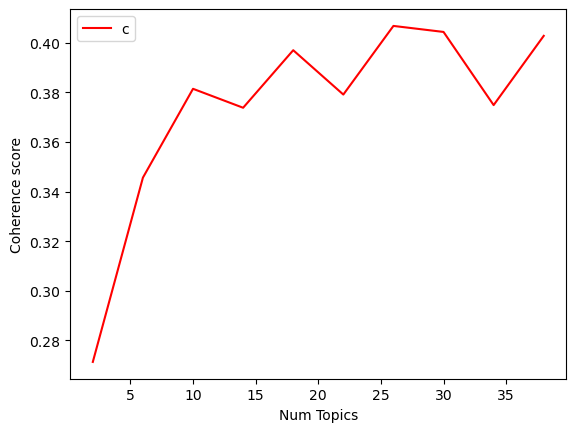

In [42]:
# Show graph
limit=40; start=2; step=4;
x = range(start, limit, step)
plt.plot(x, coherence_values,color='red')
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [43]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.2713
Num Topics = 6  has Coherence Value of 0.3456
Num Topics = 10  has Coherence Value of 0.3814
Num Topics = 14  has Coherence Value of 0.3738
Num Topics = 18  has Coherence Value of 0.3969
Num Topics = 22  has Coherence Value of 0.3791
Num Topics = 26  has Coherence Value of 0.4067
Num Topics = 30  has Coherence Value of 0.4043
Num Topics = 34  has Coherence Value of 0.3748
Num Topics = 38  has Coherence Value of 0.4027


In [36]:
# Select the model and print the topics
OPTIMAL_MODEL = model_list[3]
MODEL_TOPICS = OPTIMAL_MODEL.show_topics(formatted=False)
pprint(OPTIMAL_MODEL.print_topics(num_words=20, num_topics=40)) #

[(0,
  '0.008*"work" + 0.007*"social" + 0.006*"economic" + 0.005*"business" + '
  '0.005*"male" + 0.005*"family" + 0.004*"make" + 0.004*"informal" + '
  '0.004*"sector" + 0.004*"need" + 0.004*"interview" + 0.004*"economy" + '
  '0.003*"role" + 0.003*"new" + 0.003*"many" + 0.003*"education" + '
  '0.003*"well" + 0.003*"study" + 0.003*"country" + 0.003*"provide"'),
 (1,
  '0.041*"group" + 0.032*"rural" + 0.009*"barrier" + 0.007*"rice" + '
  '0.006*"contextual" + 0.005*"patriarchal" + 0.005*"context" + 0.005*"paddy" '
  '+ 0.004*"navigate" + 0.004*"widow" + 0.004*"feminist_separatist" + '
  '0.003*"collective" + 0.003*"engagement" + 0.003*"spatial" + 0.003*"farming" '
  '+ 0.003*"participate" + 0.002*"join" + 0.002*"participation" + '
  '0.002*"organise" + 0.002*"marry"'),
 (2,
  '0.000*"role" + 0.000*"factor" + 0.000*"family" + 0.000*"social" + '
  '0.000*"economic" + 0.000*"education" + 0.000*"support" + 0.000*"use" + '
  '0.000*"result" + 0.000*"success" + 0.000*"activity" + 0.000*"wor

In [37]:
#import tuples
#final = []
ldamodel = OPTIMAL_MODEL
texts = AFRICA_NLTK.explode('lemataized')['lemataized'].to_list()
def format_topics_sentences(ldamodel=ldamodel, corpus=corpus1, texts=texts):
    # Init output
    final = []
    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list
        row = sorted(row, key=lambda x: (x[1]),reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num,topn=20)
                topic_keywords = ", ".join([word for word, prop in wp])
                lists1 = int(topic_num), round(prop_topic,4),topic_keywords
                final.append(lists1)
            else:
                break
    sent_topics_df = pd.DataFrame(final, columns=['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords'])
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df,contents], axis=1,ignore_index=True)

    return(sent_topics_df)

df_topic_sents_keywords = format_topics_sentences(ldamodel=OPTIMAL_MODEL, corpus=corpus1, 
                                                  texts=AFRICA_NLTK.explode('lemataized')['lemataized'].to_list())

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']

# Show
df_dominant_topic.head(10)
AFRICA_NLTK['lemataized1'] = AFRICA_NLTK.explode('lemataized')['lemataized'].apply(str)
df_dominant_topic['Text1'] = df_dominant_topic['Text'].apply(str)
AFRICA_NLTK1 = pd.merge(AFRICA_NLTK, df_dominant_topic,  how='inner', 
                        left_on=['lemataized1'], right_on = ['Text1'])
AFRICA_NLTK1
#pd.DataFrame(OPTIMAL_MODEL.get_document_topics(corpus1,minimum_probability=0.0,per_word_topics=True)).head(60)

,xml|records|record|abstract,xml|records|record|accession-num,xml|records|record|contributors|authors,xml|records|record|contributors|secondary-authors,xml|records|record|dates|pub-dates,xml|records|record|dates|year,xml|records|record|electronic-resource-num,xml|records|record|issue,xml|records|record|keywords|keyword,xml|records|record|pages,...,lemataized,id2word,corpus,lemataized1,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,Text1
0,Purpose: This study seeks to examine the busin...,NaN,"{'author': ['Halkias, Daphne', 'Nwajiuba, Chin...",None,{'date': '1'},2011,10.1108/01409171111102821,2,"[Africa, Entrepreneurs, Nigeria, Poverty, Women]",221-235,...,"[[seek, examine, social, proﬁle, region, order...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 4), (1, 1), (2, 1), (3, 7), (4, 1), (5, ...","['seek', 'examine', 'social', 'proﬁle', 'regio...",0,0,0.4014,"work, social, economic, business, male, family...","[seek, examine, social, proﬁle, region, order,...","['seek', 'examine', 'social', 'proﬁle', 'regio..."
1,This paper highlights the position and role of...,NaN,"{'author': ['Woldie, Atsede', 'Adersua, Adebim...",None,NaN,2004,10.1108/03068290410515439,1-2,"[Careers, Control, Entrepreneurs, Nigeria, Women]",78-93,...,"[[signiﬁcant, contribution, sustain, socioecon...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 5), (1, 1), (2, 1), (3, 1), (4, 2), (5, ...","['signiﬁcant', 'contribution', 'sustain', 'soc...",1,0,0.7938,"work, social, economic, business, male, family...","[signiﬁcant, contribution, sustain, socioecono...","['signiﬁcant', 'contribution', 'sustain', 'soc..."
2,Purpose – The purpose of this paper is to exam...,NaN,"{'author': ['Mordi, Chima', 'Simpson, Ruth', '...",None,{'date': '2'},2010,10.1108/17542411011019904,1,"[Entrepreneurialism, Entrepreneurs, Nigeria, S...",5-21,...,"[[paper, examine, challenge, face, development...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 3), (1, 4), (2, 1), (3, 12), (4, 2), (5,...","['paper', 'examine', 'challenge', 'face', 'dev...",2,11,0.6938,"challenge, support, development, access, gover...","[paper, examine, challenge, face, development,...","['paper', 'examine', 'challenge', 'face', 'dev..."
3,Purpose: The purpose of this paper is to bring...,NaN,"{'author': 'Madichie, Nnamdi O.'}",None,{'date': '5'},2011,10.1108/17542411111130972,3,"[Education, Entrepreneurialism, Nigeria, Women]",212-219,...,"[[onal, obscurity, acknowledge, contribution, ...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 1), (1, 2), (2, 1), (3, 2), (4, 1), (5, ...","['onal', 'obscurity', 'acknowledge', 'contribu...",3,0,0.7683,"work, social, economic, business, male, family...","[onal, obscurity, acknowledge, contribution, r...","['onal', 'obscurity', 'acknowledge', 'contribu..."
4,Purpose – The purpose of this paper is to exam...,NaN,"{'author': 'Oluranti Ogunrinola, I.'}",None,{'date': '4'},2011,10.1108/20400701111110795,1,"[Entrepreneurialism, Microeconomics, Nigeria, ...",94-113,...,"[[select, approach, theoretical, foundation, c...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 3), (1, 7), (2, 2), (3, 2), (4, 1), (5, ...","['select', 'approach', 'theoretical', 'foundat...",4,5,0.6738,"loan, credit, service, access, rural, oil, cap...","[select, approach, theoretical, foundation, ca...","['select', 'approach', 'theoretical', 'foundat..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127,The Women Entrepreneurship Programme (WEP) was...,NaN,"{'author': ['Botha, Melodi', 'Nieman, Gideon',...",None,NaN,2007,10.4102/sajems.v10i2.577,2,NaN,160-183,...,"[[ne, empirical, paper, measure, effectiveness...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 1), (1, 4), (2, 29), (3, 1), (4, 1), (5,...","['ne', 'empirical', 'paper', 'measure', 'effec...",125,8,0.9652,"factor, group, training, use, measure, respond...","[ne, empirical, paper, measure, effectiveness,...","['ne', 'empiri

In [44]:
df_dominant_topic.Dominant_Topic.value_counts()
df_dominant_topic[df_dominant_topic["Dominant_Topic"]==6]
AFRICA_NLTK1[['Keywords','Dominant_Topic','Topic_Perc_Contrib',
               'CLEAN_AUTHOR','COUNTRY_STUDY']].groupby('Dominant_Topic').agg(
    lambda x: x.unique().tolist())
AFRICA_NLTK1.groupby(
    ['Dominant_Topic','xml|records|record|dates|year'])[
    'xml|records|record|dates|year'].value_counts().unstack(1,fill_value=0)

xml|records|record|dates|year,1975,1987,1989,1995,2001,2004,2005,2007,2008,2009,...,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
Dominant_Topic,,,,,,,,,,,,,,,,,,,,,
0,0,1,1,0,3,1,1,2,1,6,...,3,4,4,3,2,4,7,3,12,4
3,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,2,2,0,3,3,2
4,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0
5,0,0,0,0,0,0,0,0,1,0,...,1,2,0,1,1,0,0,0,2,1
6,0,0,0,0,0,0,0,1,1,0,...,0,0,0,0,0,0,0,0,0,1
8,1,0,0,0,0,0,0,1,0,0,...,0,0,0,1,0,1,2,0,1,0
11,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,4,0,2,2,6,2
12,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
13,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,0,1,0,0


In [58]:
# Select the model and print the topics
OPTIMAL_MODEL = model_list[2]
MODEL_TOPICS = OPTIMAL_MODEL.show_topics(formatted=False)
pprint(OPTIMAL_MODEL.print_topics(num_words=20, num_topics=40)) #

[(0,
  '0.007*"work" + 0.007*"family" + 0.006*"sector" + 0.006*"social" + '
  '0.005*"business" + 0.005*"economic" + 0.005*"support" + 0.004*"many" + '
  '0.004*"role" + 0.004*"country" + 0.004*"activity" + 0.004*"make" + '
  '0.004*"informal" + 0.004*"network" + 0.004*"male" + 0.004*"capital" + '
  '0.004*"government" + 0.004*"need" + 0.004*"access" + 0.003*"experience"'),
 (1,
  '0.072*"role" + 0.021*"cope" + 0.017*"success" + 0.016*"conflict" + '
  '0.013*"strategy" + 0.012*"expectation" + 0.010*"family" + 0.008*"social" + '
  '0.007*"personal" + 0.007*"item" + 0.007*"demand" + 0.006*"example" + '
  '0.005*"behavior" + 0.004*"affect" + 0.004*"prioritize" + 0.004*"hire" + '
  '0.004*"negatively" + 0.003*"nonfinancial" + 0.003*"behave" + '
  '0.003*"subjective"'),
 (2,
  '0.031*"identity" + 0.031*"phone" + 0.030*"mobile" + 0.013*"practice" + '
  '0.012*"social" + 0.007*"gendere" + 0.006*"relation" + 0.006*"construction" '
  '+ 0.005*"position" + 0.005*"representation" + 0.005*"discour

In [85]:
#list(DOC_LDA)#.corpus
#LDA_MODEL.id2word.doc2bow(bow_water) # convert to bag of words format first
#doc_topics, word_topics, phi_values = 
#LDA_MODEL.get_document_topics(LDA_MODEL.id2word.doc2bow(bow_water), per_word_topics=True)
topics = OPTIMAL_MODEL.get_document_topics([corpora.Dictionary(AFRICA_NLTK.explode('lemataized')['lemataized']).doc2bow(text) for text in 
            AFRICA_NLTK.explode('lemataized')['lemataized']], per_word_topics=True,minimum_probability=0.0)
all_topics = [(doc_topics, word_topics, word_phis) for doc_topics, word_topics, word_phis in topics]
#doc_topics, word_topics, phi_values = all_topics[0]
for doc in all_topics:
    print('New Document \n')
    print('Document topic:', doc[0])
    print('Word topic:', doc[1])
    print('Phi value:', doc[2])
    print(" ")
    print('-------------- \n')

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[(0, [(3, 0.99971354)]), (1, [(3, 2.998112)]), (3, [(3, 4.998938)]), (4, [(3, 3.9983606)]), (6, [(3, 2.999531)]), (8, [(3, 1.9993871)]), (11, [(3, 5.9990387)]), (13, [(3, 1.9997058)]), (16, [(3, 1.9985452)]), (25, [(3, 0.998486)]), (28, [(3, 0.9996569)]), (30, [(3, 17.997696)]), (31, [(3, 1.9995457)]), (32, [(3, 0.99706554)]), (33, [(3, 0.9997864)]), (37, [(3, 5.9971986)]), (39, [(3, 3.9966195)]), (40, [(3, 1.9964467)]), (45, [(3, 1.9996989)]), (46, [(3, 1.9992453)]), (47, [(3, 1.9975474)]), (50, [(3, 0.9997637)]), (61, [(3, 3.9988458)]), (63, [(3, 0.9997096)]), (64, [(3, 8.9980345)]), (65, [(3, 0.9969361)]), (67, [(3, 0.9990208)]), (68, [(3, 2.9992712)]), (72, [(3, 5.998851)]), (73, [(3, 0.99991304)]), (75, [(3, 0.9991779)]), (76, [(3, 1.9980797)]), (80, [(3, 5.9971447)]), (81, [(3, 0.9994981)]), (82, [(3, 0.9996792)]), (83, [(3, 3.9980917)]), (89, [(3, 2.9987564)]), (92, [(3, 2.9976227)]), (95, [(3, 0.9998557)]), (98, [(3, 3.9992852)]), (104, [(3, 7.999292)]), (105, [(3, 3.9975922)])

In [59]:
#import tuples
#final = []
ldamodel = OPTIMAL_MODEL
texts = AFRICA_NLTK.explode('lemataized')['lemataized'].to_list()
def format_topics_sentences(ldamodel=ldamodel, corpus=corpus1, texts=texts):
    # Init output
    final = []
    # Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list
        row = sorted(row, key=lambda x: (x[1]),reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num,topn=20)
                topic_keywords = ", ".join([word for word, prop in wp])
                lists1 = int(topic_num), round(prop_topic,4),topic_keywords
                final.append(lists1)
            else:
                break
    sent_topics_df = pd.DataFrame(final, columns=['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords'])
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df,contents], axis=1,ignore_index=True)

    return(sent_topics_df)

df_topic_sents_keywords = format_topics_sentences(ldamodel=OPTIMAL_MODEL, corpus=corpus1, 
                                                  texts=AFRICA_NLTK.explode('lemataized')['lemataized'].to_list())

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']

# Show
df_dominant_topic.head(10)
AFRICA_NLTK['lemataized1'] = AFRICA_NLTK.explode('lemataized')['lemataized'].apply(str)
df_dominant_topic['Text1'] = df_dominant_topic['Text'].apply(str)
AFRICA_NLTK1 = pd.merge(AFRICA_NLTK, df_dominant_topic,  how='inner', 
                        left_on=['lemataized1'], right_on = ['Text1'])
AFRICA_NLTK1
#pd.DataFrame(OPTIMAL_MODEL.get_document_topics(corpus1,minimum_probability=0.0,per_word_topics=True)).head(60)

,xml|records|record|abstract,xml|records|record|accession-num,xml|records|record|contributors|authors,xml|records|record|contributors|secondary-authors,xml|records|record|dates|pub-dates,xml|records|record|dates|year,xml|records|record|electronic-resource-num,xml|records|record|issue,xml|records|record|keywords|keyword,xml|records|record|pages,...,lemataized,id2word,corpus,lemataized1,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,Text1
0,Purpose: This study seeks to examine the busin...,NaN,"{'author': ['Halkias, Daphne', 'Nwajiuba, Chin...",None,{'date': '1'},2011,10.1108/01409171111102821,2,"[Africa, Entrepreneurs, Nigeria, Poverty, Women]",221-235,...,"[[seek, examine, social, proﬁle, region, order...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 4), (1, 1), (2, 1), (3, 7), (4, 1), (5, ...","['seek', 'examine', 'social', 'proﬁle', 'regio...",0,0,0.6629,"work, family, sector, social, business, econom...","[seek, examine, social, proﬁle, region, order,...","['seek', 'examine', 'social', 'proﬁle', 'regio..."
1,This paper highlights the position and role of...,NaN,"{'author': ['Woldie, Atsede', 'Adersua, Adebim...",None,NaN,2004,10.1108/03068290410515439,1-2,"[Careers, Control, Entrepreneurs, Nigeria, Women]",78-93,...,"[[signiﬁcant, contribution, sustain, socioecon...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 5), (1, 1), (2, 1), (3, 1), (4, 2), (5, ...","['signiﬁcant', 'contribution', 'sustain', 'soc...",1,0,0.9582,"work, family, sector, social, business, econom...","[signiﬁcant, contribution, sustain, socioecono...","['signiﬁcant', 'contribution', 'sustain', 'soc..."
2,Purpose – The purpose of this paper is to exam...,NaN,"{'author': ['Mordi, Chima', 'Simpson, Ruth', '...",None,{'date': '2'},2010,10.1108/17542411011019904,1,"[Entrepreneurialism, Entrepreneurs, Nigeria, S...",5-21,...,"[[paper, examine, challenge, face, development...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 3), (1, 4), (2, 1), (3, 12), (4, 2), (5,...","['paper', 'examine', 'challenge', 'face', 'dev...",2,0,0.8425,"work, family, sector, social, business, econom...","[paper, examine, challenge, face, development,...","['paper', 'examine', 'challenge', 'face', 'dev..."
3,Purpose: The purpose of this paper is to bring...,NaN,"{'author': 'Madichie, Nnamdi O.'}",None,{'date': '5'},2011,10.1108/17542411111130972,3,"[Education, Entrepreneurialism, Nigeria, Women]",212-219,...,"[[onal, obscurity, acknowledge, contribution, ...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 1), (1, 2), (2, 1), (3, 2), (4, 1), (5, ...","['onal', 'obscurity', 'acknowledge', 'contribu...",3,0,0.7512,"work, family, sector, social, business, econom...","[onal, obscurity, acknowledge, contribution, r...","['onal', 'obscurity', 'acknowledge', 'contribu..."
4,Purpose – The purpose of this paper is to exam...,NaN,"{'author': 'Oluranti Ogunrinola, I.'}",None,{'date': '4'},2011,10.1108/20400701111110795,1,"[Entrepreneurialism, Microeconomics, Nigeria, ...",94-113,...,"[[select, approach, theoretical, foundation, c...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 3), (1, 7), (2, 2), (3, 2), (4, 1), (5, ...","['select', 'approach', 'theoretical', 'foundat...",4,6,0.4863,"factor, use, training, group, level, education...","[select, approach, theoretical, foundation, ca...","['select', 'approach', 'theoretical', 'foundat..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125,The Women Entrepreneurship Programme (WEP) was...,NaN,"{'author': ['Botha, Melodi', 'Nieman, Gideon',...",None,NaN,2007,10.4102/sajems.v10i2.577,2,NaN,160-183,...,"[[ne, empirical, paper, measure, effectiveness...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 1), (1, 4), (2, 29), (3, 1), (4, 1), (5,...","['ne', 'empirical', 'paper', 'measure', 'effec...",125,6,0.9997,"factor, use, training, group, level, education...","[ne, empirical, paper, measure, effectiveness,...","['ne', 'empiric

In [60]:
df_dominant_topic.Dominant_Topic.value_counts()

Dominant_Topic
0    78
6    41
5     5
2     3
1     1
7     1
4     1
Name: count, dtype: int64

In [130]:
#AFRICA_NLTK1.groupby('Dominant_Topic').agg(lambda x: x.unique().tolist()).to_csv('TOPIC_INFO.csv')
AFRICA_NLTK1[['Keywords','Dominant_Topic','Topic_Perc_Contrib',
               'CLEAN_AUTHOR','COUNTRY_STUDY']].groupby('Dominant_Topic').agg(
    lambda x: x.unique().tolist()).to_csv('TOPIC_INFO1.csv')

,Keywords,Topic_Perc_Contrib,CLEAN_AUTHOR,COUNTRY_STUDY
Dominant_Topic,,,,
0,"[work, family, sector, social, business, suppo...","[0.6538000106811523, 0.9545000195503235, 0.838...","['Halkias, Daphne', 'Nwajiuba, Chinedum', 'Har...","['NIGERIA', <NA>, 'UGANDA', 'SOUTH AFRICA', 'C..."
1,"[role, cope, success, conflict, strategy, expe...",[0.45410001277923584],"['Hundera, Mulu Berhanu', 'Duysters, Geert', '...",['ETHIOPIA']
2,"[phone, identity, mobile, practice, social, ge...","[0.44830000400543213, 0.7157999873161316, 0.56...","['Hayhurst, Lyndsay M.C.', 'Lo, Marieme S.', '...","['UGANDA', 'SENEGAL']"
4,"[tourism, church, pandemic, people, use, belie...",[0.8970000147819519],"['Ojong, Vivian Besem']",['GHANA']
5,"[loan, group, family, microfinance, oil, norm,...","[0.4088999927043915, 0.4316999912261963, 0.435...","['Lindvert, Marta', 'Yazdanfar, Darush', 'Bote...","['TANZANIA', 'NIGERIA']"
6,"[factor, use, training, group, level, result, ...","[0.492900013923645, 0.6739000082015991, 0.4404...","['Oluranti Ogunrinola, I.', 'Ama, Njoku O.', '...","['NIGERIA', 'BOTSWANA', 'ETHIOPIA', 'GHANA', '..."
7,"[cultural, transport, firm, informal, rural, a...",[0.7501999735832214],"['Stanley, Liz', 'Dampier, Helen']",['SOUTH AFRICA']


In [82]:
AFRICA_NLTK1[['Keywords','Dominant_Topic','Topic_Perc_Contrib',
               'CLEAN_AUTHOR','COUNTRY_STUDY']].groupby('Dominant_Topic').agg(
    lambda x: x.unique().tolist()).CLEAN_AUTHOR.str.len()
AFRICA_NLTK1[['Keywords','Dominant_Topic','Topic_Perc_Contrib',
               'CLEAN_AUTHOR','COUNTRY_STUDY']].groupby('Dominant_Topic').agg(
    lambda x: x.unique().tolist()).Topic_Perc_Contrib.apply(min)
#AFRICA_NLTK1[AFRICA_NLTK1['CLEAN_AUTHOR'].astype(str).str.contains('bujra')]
#AFRICA_NLTK1[AFRICA_NLTK1['xml|records|record|dates|year']=='1975']
AFRICA_NLTK1[['Keywords','Dominant_Topic','Topic_Perc_Contrib',
               'CLEAN_AUTHOR','COUNTRY_STUDY']].groupby('Dominant_Topic').agg(
    lambda x: x.unique().tolist()).Topic_Perc_Contrib.apply(max)
AFRICA_NLTK1[(AFRICA_NLTK1['Topic_Perc_Contrib'] > 0.8) & (AFRICA_NLTK1['Dominant_Topic'] ==6)].

,xml|records|record|abstract,xml|records|record|accession-num,xml|records|record|contributors|authors,xml|records|record|contributors|secondary-authors,xml|records|record|dates|pub-dates,xml|records|record|dates|year,xml|records|record|electronic-resource-num,xml|records|record|issue,xml|records|record|keywords|keyword,xml|records|record|pages,...,lemataized,id2word,corpus,lemataized1,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text,Text1
24,Purpose: Despite the increase in female entrep...,NaN,"{'author': ['Corrêa, Victor Silva', 'Brito, Fe...",None,{'date': '8'},2022,10.1108/IJGE-08-2021-0142,3,"[Female self-employment, Gender, Women entrepr...",300-322,...,"[[literature, study, exist, systematize, extan...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 1), (1, 1), (2, 3), (3, 1), (4, 1), (5, ...","['literature', 'study', 'exist', 'systematize'...",24,6,0.8880,"factor, use, training, group, level, education...","[literature, study, exist, systematize, extant...","['literature', 'study', 'exist', 'systematize'..."
46,An investigation of the intentions and knowled...,NaN,"{'author': ['Brijlal, Pradeep', 'Brijlal, Pris...",None,{'date': '10'},2013,10.5367/ihe.2013.0171,5,"[South Africa, dentistry students, entrepreneu...",389-398,...,"[[race, use, ﬁnalyear, dentistry, student, yea...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 1), (1, 1), (2, 4), (3, 3), (4, 1), (5, ...","['race', 'use', 'ﬁnalyear', 'dentistry', 'stud...",46,6,0.9009,"factor, use, training, group, level, education...","[race, use, ﬁnalyear, dentistry, student, year...","['race', 'use', 'ﬁnalyear', 'dentistry', 'stud..."
59,Subsistence women in developing economies are ...,NaN,"{'author': ['Mandongwe, Lucia', 'Jaravaza, Div...",None,{'date': '1'},2020,10.1080/23311975.2020.1818365,1,"[entrepreneurial intention, entrepreneurial or...",NaN,...,"[[divarie, divarie, intention, subsistence, ma...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 8), (1, 1), (2, 1), (3, 1), (4, 1), (5, ...","['divarie', 'divarie', 'intention', 'subsisten...",59,6,0.8289,"factor, use, training, group, level, education...","[divarie, divarie, intention, subsistence, mar...","['divarie', 'divarie', 'intention', 'subsisten..."
70,Although entrepreneurship training may improve...,NaN,"{'author': ['Gavigan, Sylvia', 'Ciprikis, Klav...",None,NaN,2020,10.1080/13215906.2020.1769715,2,"[Entrepreneurship training, Uganda, business c...",180-194,...,"[[article, train, selfemployment, small, enter...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 2), (1, 3), (2, 1), (3, 1), (4, 3), (5, ...","['article', 'train', 'selfemployment', 'small'...",70,6,0.8958,"factor, use, training, group, level, education...","[article, train, selfemployment, small, enterp...","['article', 'train', 'selfemployment', 'small'..."
79,Technical and vocational education and trainin...,NaN,"{'author': ['Padi, Abigail', 'Dzisi, Prof Smil...",None,NaN,2022,10.1080/23311975.2022.2137954,1,"[Entrepreneurial intentions, Entrepreneurship ...",NaN,...,"[[education, institution, intention, student, ...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 2), (1, 3), (2, 1), (3, 2), (4, 2), (5, ...","['education', 'institution', 'intention', 'stu...",79,6,0.8163,"factor, use, training, group, level, education...","[education, institution, intention, student, s...","['education', 'institution', 'intention', 'stu..."
81,This research examined how key entrepreneurial...,NaN,"{'author': ['Dossou, Smith A.R.', 'Adeoti, Raz...",None,NaN,2021,10.1080/20421338.2021.2003510,NaN,"[innovativeness, performance, pro-activeness, ...",NaN,...,"[[social, environment, matter, augustin, augus...","(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[[(0, 3), (1, 4), (2, 2), (3, 1), (4, 4), (5, ...","['social', 'environment', 'matter', 'augustin'...",81,6,0.8033,"factor, use, training, group, level, education...","[social, environment, matter, augustin, august...","['social', 'enviro

In [90]:
AFRICA_NLTK1.groupby(
    ['Dominant_Topic','xml|records|record|dates|year'])[
    'xml|records|record|dates|year'].value_counts().unstack(1,fill_value=0).to_csv('YEARLY_TOPIC_DIST.csv')

In [123]:
# Group top 5 sentences under each topic
SORTED_DF = pd.DataFrame()
GROUPED = df_topic_sents_keywords.groupby(0)
for i, grp in GROUPED:
    SORTED_DF = pd.concat([SORTED_DF, grp.sort_values([1], ascending=[0]).head(1)], 
                                            axis=0) 
# Reset Index    
SORTED_DF.reset_index(drop=True, inplace=True)
# Format
SORTED_DF.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Text"]
# Show
SORTED_DF.head(10)

,Topic_Num,Topic_Perc_Contrib,Keywords,Text
0,0,0.9998,"work, family, sector, social, business, suppor...","[preliminary, investigation, journal, african,..."
1,1,0.4541,"role, cope, success, conflict, strategy, expec...","[duyster, article, duyster, role, conflict, in..."
2,2,0.7158,"phone, identity, mobile, practice, social, gen...","[article, diasporic, network, reconfiguration,..."
3,4,0.8970,"tourism, church, pandemic, people, use, believ...","[wide, range, content, trust, digital, archive..."
4,5,0.9998,"loan, group, family, microfinance, oil, norm, ...","[article, microfinance, trap, relational, exch..."
5,6,0.9997,"factor, use, training, group, level, result, e...","[author, date, publish, structural, validity, ..."
6,7,0.7502,"cultural, transport, firm, informal, rural, af...","[article, cultural, testimony, writing, south,..."


In [124]:
# Number of Documents for Each Topic
topic_counts = df_topic_sents_keywords[0].value_counts()
# Percentage of Documents for Each Topic
topic_contribution = round(topic_counts/topic_counts.sum(), 4)
# Topic Number and Keywords
topic_num_keywords = df_topic_sents_keywords[[1, 2]]
# Concatenate Column wise
df_dominant_topics = pd.concat([topic_num_keywords, topic_counts, topic_contribution], axis=1)
# Change Column names
df_dominant_topics.columns = ['Dominant_Topic', 'Topic_Keywords', 'Num_Documents', 'Perc_Documents']
# Show
df_dominant_topics.head(8)

,Dominant_Topic,Topic_Keywords,Num_Documents,Perc_Documents
0,0.6538,"work, family, sector, social, business, suppor...",78.0,0.6000
1,0.9545,"work, family, sector, social, business, suppor...",1.0,0.0077
2,0.8389,"work, family, sector, social, business, suppor...",3.0,0.0231
3,0.7549,"work, family, sector, social, business, suppor...",NaN,NaN
4,0.4929,"factor, use, training, group, level, result, e...",1.0,0.0077
5,0.6412,"work, family, sector, social, business, suppor...",5.0,0.0385
6,0.4238,"work, family, sector, social, business, suppor...",41.0,0.3154
7,0.6230,"work, family, sector, social, business, suppor...",1.0,0.0077


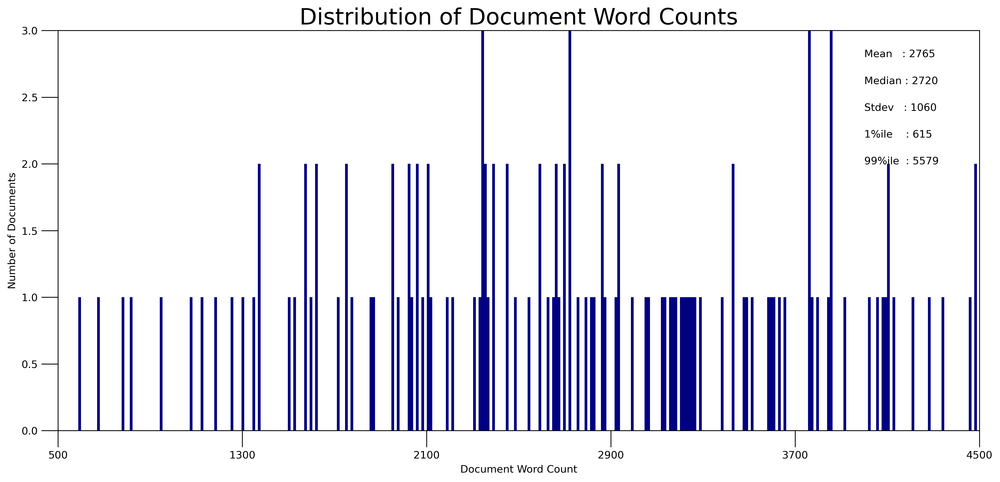

In [79]:
doc_lens = [len(d) for d in df_dominant_topic.Text]

# Plot
plt.figure(figsize=(16,7), dpi=300)
plt.hist(doc_lens, bins = 500, color='navy')
plt.text(4000, 2.8, "Mean   : " + str(round(np.mean(doc_lens))))
plt.text(4000,  2.6, "Median : " + str(round(np.median(doc_lens))))
plt.text(4000,  2.4, "Stdev   : " + str(round(np.std(doc_lens))))
plt.text(4000,  2.2, "1%ile    : " + str(round(np.quantile(doc_lens, q=0.01))))
plt.text(4000,  2.0, "99%ile  : " + str(round(np.quantile(doc_lens, q=0.99))))

plt.gca().set(xlim=(500, 4500),ylim=(0, 3), ylabel='Number of Documents', xlabel='Document Word Count')
plt.tick_params(size=16)
plt.xticks(np.linspace(500,4500,6))
plt.title('Distribution of Document Word Counts', fontdict=dict(size=22))
plt.show()

C:\Users\admin\AppData\Local\Temp\ipykernel_29752\58725780.py:10: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(doc_lens, color="black", fill=False, ax=ax.twinx())


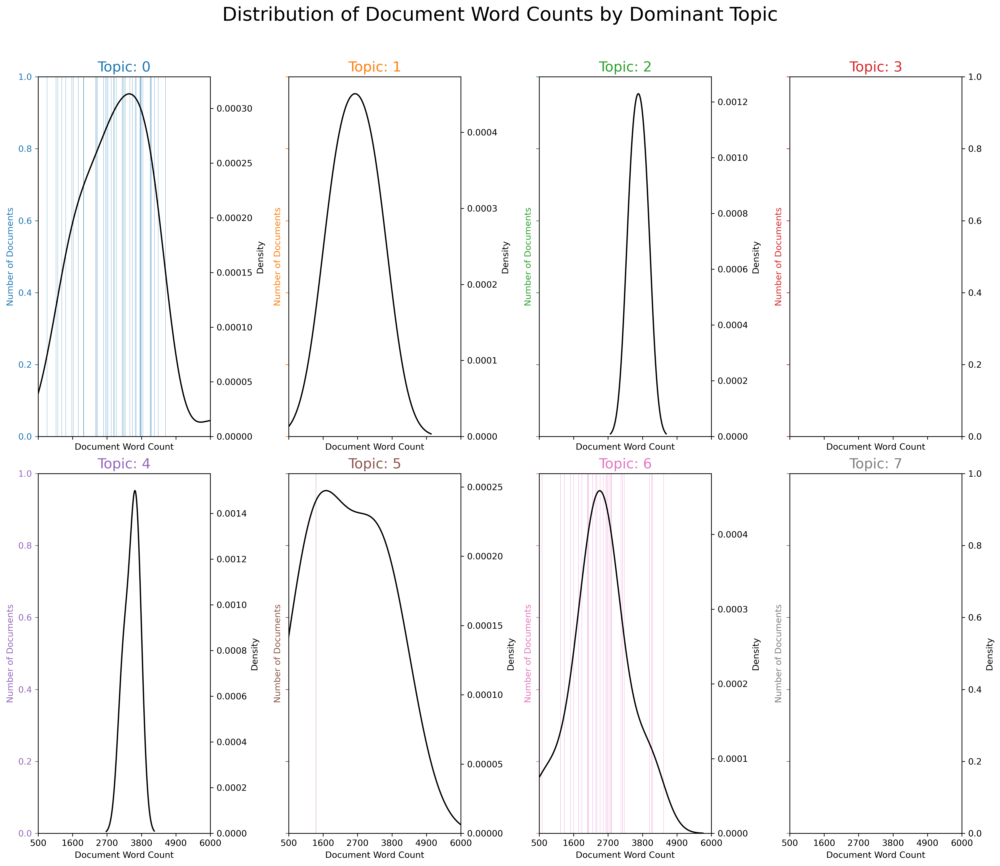

In [57]:
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

fig, axes = plt.subplots(2,4,figsize=(16,14), dpi=300, sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):    
    df_dominant_topic_sub = df_dominant_topic.loc[df_dominant_topic.Dominant_Topic == i, :]
    doc_lens = [len(d) for d in df_dominant_topic_sub.Text]
    ax.hist(doc_lens, bins = 1000, color=cols[i])
    ax.tick_params(axis='y', labelcolor=cols[i], color=cols[i])
    sns.kdeplot(doc_lens, color="black", fill=False, ax=ax.twinx())
    ax.set(xlim=(500, 6000), xlabel='Document Word Count',ylim=(0, 1))
    ax.set_ylabel('Number of Documents', color=cols[i])
    ax.set_title('Topic: '+str(i), fontdict=dict(size=16, color=cols[i]))

fig.tight_layout()
fig.subplots_adjust(top=0.90)
plt.xticks(np.linspace(500,6000,6))
fig.suptitle('Distribution of Document Word Counts by Dominant Topic', fontsize=22)
plt.show()

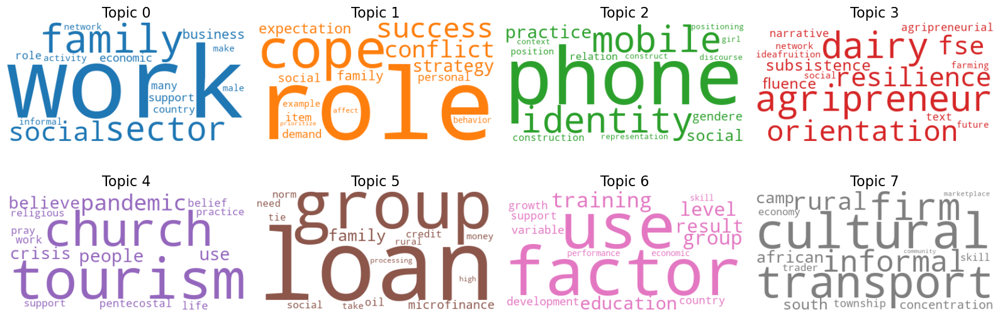

In [137]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                   max_font_size=150, random_state=130,
                  #width=2500,
                  #height=1800,
                  #max_words=10,
                  colormap='Dark2',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = OPTIMAL_MODEL.show_topics(formatted=False,num_words=15)

fig, axes = plt.subplots(2, 4, figsize=(16,6), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud,interpolation='bilinear')
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

C:\Users\admin\AppData\Local\Temp\ipykernel_3912\719010623.py:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')


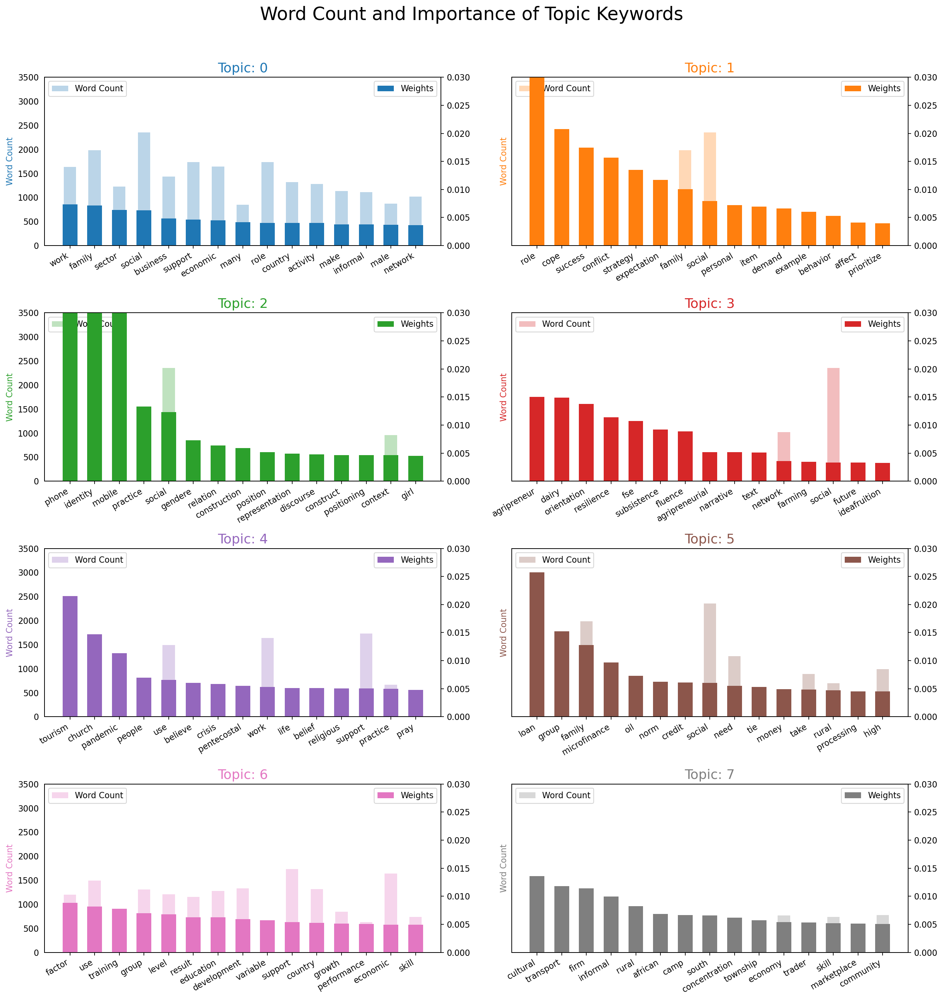

In [136]:
from collections import Counter
topics = OPTIMAL_MODEL.show_topics(formatted=False, num_words=15)
data_flat = [w for w_list in AFRICA_NLTK.explode('lemataized')['lemataized'].to_list() for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(4,2, figsize=(16,16), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.6, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 3500)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.show()

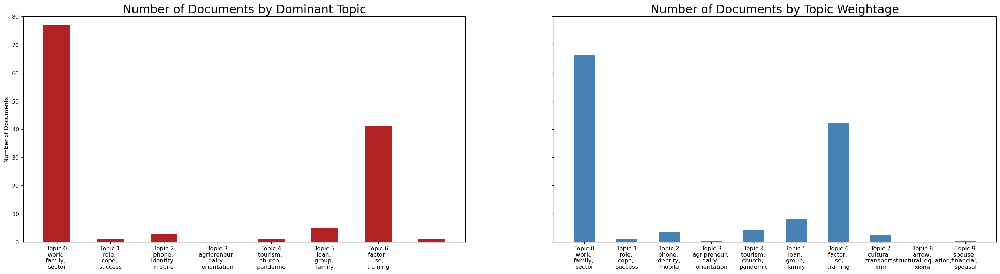

In [127]:
def topics_per_document(model, corpus, start=0, end=1):
    corpus_sel = corpus[start:end]
    dominant_topics = []
    topic_percentages = []
    for i, corp in enumerate(corpus_sel):
        topic_percs, wordid_topics, wordid_phivalues = model[corp]
        dominant_topic = sorted(topic_percs, key = lambda x: x[1], reverse=True)[0][0]
        dominant_topics.append((i, dominant_topic))
        topic_percentages.append(topic_percs)
    return(dominant_topics, topic_percentages)

dominant_topics, topic_percentages = topics_per_document(model=OPTIMAL_MODEL, corpus=corpus1, end=-1)            

# Distribution of Dominant Topics in Each Document
df = pd.DataFrame(dominant_topics, columns=['Document_Id', 'Dominant_Topic'])
dominant_topic_in_each_doc = df.groupby('Dominant_Topic').size()
df_dominant_topic_in_each_doc = dominant_topic_in_each_doc.to_frame(name='count').reset_index()

# Total Topic Distribution by actual weight
topic_weightage_by_doc = pd.DataFrame([dict(t) for t in topic_percentages])
df_topic_weightage_by_doc = topic_weightage_by_doc.sum().to_frame(name='count').reset_index()

# Top 3 Keywords for each Topic
topic_top3words = [(i, topic) for i, topics in OPTIMAL_MODEL.show_topics(formatted=False) 
                                 for j, (topic, wt) in enumerate(topics) if j < 3]

df_top3words_stacked = pd.DataFrame(topic_top3words, columns=['topic_id', 'words'])
df_top3words = df_top3words_stacked.groupby('topic_id').agg(', \n'.join)
df_top3words.reset_index(level=0,inplace=True)
#Let’s make two plots:
#The number of documents for each topic by assigning the document to the topic that has the most weight in that document.
#The number of documents for each topic by by summing up the actual weight contribution of each topic to respective documents.
from matplotlib.ticker import FuncFormatter

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 7), dpi=120, sharey=True)

# Topic Distribution by Dominant Topics
ax1.bar(x='Dominant_Topic', height='count', data=df_dominant_topic_in_each_doc, width=.5, color='firebrick')
ax1.set_xticks(range(df_dominant_topic_in_each_doc.Dominant_Topic.unique().__len__()))
tick_formatter = FuncFormatter(lambda x, pos: 'Topic ' + str(x)+ '\n' + df_top3words.loc[df_top3words.topic_id==x, 'words'].values[0])
ax1.xaxis.set_major_formatter(tick_formatter)
ax1.set_title('Number of Documents by Dominant Topic', fontdict=dict(size=20))
ax1.set_ylabel('Number of Documents')
ax1.set_ylim(0, 80)

# Topic Distribution by Topic Weights
ax2.bar(x='index', height='count', data=df_topic_weightage_by_doc, width=.5, color='steelblue')
ax2.set_xticks(range(df_topic_weightage_by_doc.index.unique().__len__()))
ax2.xaxis.set_major_formatter(tick_formatter)
ax2.set_title('Number of Documents by Topic Weightage', fontdict=dict(size=20))

plt.show()

In [164]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(OPTIMAL_MODEL, corpus1, dictionary=OPTIMAL_MODEL.id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.115394  0.003162       1        1  48.181862
6     -0.050261  0.014557       2        1  13.295107
3     -0.090676 -0.160076       3        1  13.156043
4     -0.072529  0.020244       4        1  11.191693
2     -0.010104  0.096376       5        1   8.978685
5      0.042785  0.073400       6        1   5.050258
1      0.296178 -0.047663       7        1   0.146351, topic_info=            Term         Freq        Total Category  logprob  loglift
542         loan  1116.000000  1116.000000  Default  30.0000  30.0000
418        group  1428.000000  1428.000000  Default  29.0000  29.0000
2995     student   187.000000   187.000000  Default  28.0000  28.0000
817         role  1458.000000  1458.000000  Default  27.0000  27.0000
867       social  1948.000000  1948.000000  Default  26.0000  26.0000
...          ...          ...          ...      ...      ...      ...
779       regard     0.756692   500.869874   Topic7  -6.5456   0.0318
858   signiﬁcant     0.391946    84.749305   Topic7  -7.2034   1.1506
4100    tertiary     0.276725    38.220058   Topic7  -7.5515   1.5988
515    knowledge     0.235413   408.998663   Topic7  -7.7132  -0.9332
887        start     0.215851   903.241375   Topic7  -7.8000  -1.8122

[536 rows x 6 columns], token_table=       Topic      Freq       Term
term                             
15752      6  0.933855      aawes
4759       1  0.859196  abusiness
3          1  0.389769     access
3          2  0.090974     access
3          3  0.033385     access
...      ...       ...        ...
1057       1  0.075720   ﬁnancial
1057       2  0.276771   ﬁnancial
1057       3  0.026111   ﬁnancial
1057       4  0.506544   ﬁnancial
1057       5  0.114886   ﬁnancial

[1339 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 7, 4, 5, 3, 6, 2])

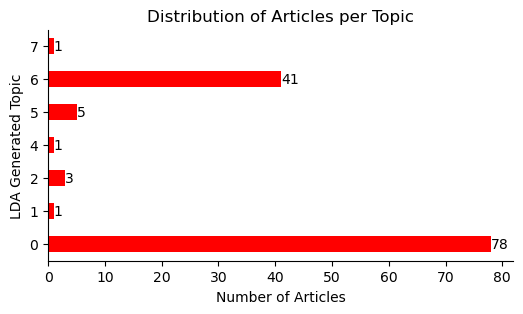

In [135]:
#df_dominant_topic.groupby('Dominant_Topic').size().plot.bar()
ax = df_dominant_topic.groupby('Dominant_Topic').size(
).plot(kind='barh',title='Distribution of Articles per Topic',xlabel='Number of Articles',
                    ylabel='LDA Generated Topic',color='r',figsize=(6,3))
for c in ax.containers:
    # set the bar label
    ax.bar_label(c, fmt='%.0f', label_type='edge')

#ax.legend(title='count per journal', bbox_to_anchor=(1, 1.02), loc='upper left')

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.show()

In [146]:
#df_dominant_topic.Dominant_Topic.value_counts()
#df_dominant_topic['Text1'] = df_dominant_topic['Text'].apply(str)
#TOP_ONLY = df_dominant_topic.groupby(['Text1','Dominant_Topic']).agg(
#    {'Topic_Perc_Contrib':'max','Keywords':'first'}).reset_index()#.Dominant_Topic.value_counts()
#TOP_ONLY[(TOP_ONLY.Topic_Perc_Contrib.duplicated())]
#df_dominant_topic#.Dominant_Topic.value_counts()

In [71]:
#doc_topics, word_topics, phi_values = sorted([OPTIMAL_MODEL.get_document_topics(item,per_word_topics=True, minimum_probability=0.0,) for item in 
#                                              [corpora.Dictionary(AFRICA_NLTK.explode('lemataized')['lemataized']).doc2bow(text) for text in 
#            AFRICA_NLTK.explode('lemataized')['lemataized']]],key=lambda x: (x[1]),reverse=False)

In [ ]:
all_topics = OPTIMAL_MODEL.get_document_topics(corpus, minimum_probability=0.0)
all_topics_csr = gensim.matutils.corpus2csc(all_topics)
all_topics_numpy = all_topics_csr.T.toarray()
all_topics_df = pd.DataFrame(all_topics_numpy)
all_topics_df.tail(60)

In [75]:
print(len(id2word_VECTORISED))
print(len([[(id2word_VECTORISED[id], freq) for id, freq in cp] for cp in corpus_VECTORISED[:130]]))

19338
19609
130
[(0,
  '0.006*"tourism" + 0.006*"business" + 0.005*"support" + 0.005*"development" '
  '+ 0.005*"sector" + 0.005*"country" + 0.005*"access" + 0.005*"social" + '
  '0.005*"economic" + 0.005*"growth" + 0.004*"activity" + 0.004*"use"'),
 (1,
  '0.015*"family" + 0.014*"loan" + 0.012*"group" + 0.007*"microfinance" + '
  '0.006*"challenge" + 0.006*"work" + 0.006*"social" + 0.005*"norm" + '
  '0.005*"start" + 0.005*"take" + 0.005*"need" + 0.005*"factor"'),
 (2,
  '0.012*"education" + 0.009*"variable" + 0.008*"economic" + 0.007*"result" + '
  '0.006*"level" + 0.006*"effect" + 0.005*"capital" + 0.005*"model" + '
  '0.005*"informal" + 0.005*"show" + 0.005*"economy" + 0.005*"family"'),
 (3,
  '0.006*"social" + 0.006*"work" + 0.005*"water" + 0.005*"make" + '
  '0.004*"worker" + 0.004*"people" + 0.004*"church" + 0.004*"informal" + '
  '0.004*"many" + 0.004*"practice" + 0.004*"case" + 0.003*"sector"'),
 (4,
  '0.030*"mobile" + 0.030*"phone" + 0.020*"identity" + 0.007*"social" + '
  '

In [47]:
print(len(id2word_VECTORISED.keys()))
#print(corpus[:1])
#len(id2word.keys())
len(corpora.Dictionary(AFRICA_NLTK.explode('lemataized')['lemataized']).keys())

19338


19340

In [97]:
list(OPTIMAL_MODEL[corpus1])
#list(zip([a for [(a,b)] in list(OPTIMAL_MODEL[corpus1])], list(data_stop_VECTORISED.index)))

[([(0, 0.8860104),
   (1, 4.841148e-06),
   (2, 1.5228217e-05),
   (3, 0.01531736),
   (4, 0.098622166),
   (5, 9.573722e-06),
   (6, 2.0389762e-05)],
  [(0, [0, 4, 3]),
   (1, [0, 4, 3]),
   (2, [0, 4]),
   (3, [0, 4, 3]),
   (4, [0, 4]),
   (5, [0, 3]),
   (6, [0, 4, 3]),
   (7, [0, 3]),
   (8, [0, 4, 3]),
   (9, [0]),
   (10, [0]),
   (11, [0, 4, 3]),
   (12, [0, 4]),
   (13, [0, 4, 3]),
   (14, [0, 3, 4]),
   (15, [0, 4]),
   (16, [0, 4]),
   (17, [0, 4]),
   (18, [0, 4, 3]),
   (19, [0]),
   (20, [0, 4]),
   (21, [0]),
   (22, [0, 4]),
   (23, [3, 0]),
   (24, [0, 4]),
   (25, [0, 4]),
   (26, [0]),
   (27, [0, 4]),
   (28, [0, 4]),
   (29, [0, 4]),
   (30, [0, 4, 3]),
   (31, [0, 4, 3]),
   (32, [0]),
   (33, [0, 3, 4]),
   (34, [0, 4, 3]),
   (35, [0]),
   (36, [4, 0]),
   (37, [0, 4, 3]),
   (38, [0, 4, 3]),
   (39, [0, 4]),
   (40, [0, 4]),
   (41, [0, 4, 3]),
   (42, [0, 4]),
   (43, [0]),
   (44, [0, 4, 3]),
   (45, [0, 4, 3]),
   (46, [0, 4, 3]),
   (47, [0, 3]),
   (48, [0

In [77]:
list(zip([a for [(a,b)] in list(DOC_LDA)], list(data_stop_VECTORISED.index)))
list(DOC_LDA)
list(data_stop_VECTORISED.index)
TRANSFORMED = {"topic_group1": [], "topic_group2": [], "Documnets": []}
for a,*b in list(corpus_transformed):
    for c in list(data_dtmna.index):
        data_all1 = max(a),b,c
        for key, value in zip(TRANSFORMED.keys(), data_all1):
            TRANSFORMED[key].append(value)

TRANSFORMED_DF = pd.DataFrame(TRANSFORMED)

ValueError: too many values to unpack (expected 1)

In [164]:
print(AFRICA_NLTK['corpus'][0][0][0])
print(AFRICA_NLTK['id2word'][0][0])
#AFRICA_NLTK['id2word'].apply(lambda x: x.merge_with(dict(x)))#.values[8]
len([[(AFRICA_NLTK['id2word'][0][id], freq) for id, freq in cp] for cp in AFRICA_NLTK['corpus'].apply(pd.Series)[0].tolist()[:9]])
#len([[(AFRICA_NLTK['id2word'][id][id], freq) for id, freq in cp] for cp in AFRICA_NLTK['corpus'].apply(pd.Series)[0].values[:129]])

(0, 4)
ability


9

In [75]:
def ldamodelrun(x,y):
    return gensim.models.ldamodel.LdaModel(corpus=x,id2word=y,num_topics=8, random_state=100,update_every=1,
                                           chunksize=100, passes=4, alpha='auto', per_word_topics=True)
#ldaresult = ldamodelrun(AFRICA_NLTK['id2word'].tolist(), AFRICA_NLTK['corpus'].apply(pd.Series)[0].tolist())
# Build LDA model
#lda_model = gensim.models.ldamodel.LdaModel(
#    corpus=corpus,id2word=id2word,num_topics=8, random_state=100,update_every=1,
#    chunksize=100, passes=4, alpha='auto', per_word_topics=True)
AFRICA_NLTK.corpus.explode()
AFRICA_NLTK['corpus'].apply(pd.Series)[0].tolist()#[:1]
AFRICA_NLTK['id2word'].values#tolist()[0])
len(AFRICA_NLTK['corpus'].apply(pd.Series)[0].tolist()[200:1000])

0

In [41]:
print(len(AFRICA_NLTK['tokenized'][0]))
print(len(AFRICA_NLTK['nostop_words'][0][0]))
print(len(AFRICA_NLTK['bigrams'][0][0]))
print(len(AFRICA_NLTK['lemataized'][0][0]))
print(len(AFRICA_NLTK['id2word'][0]))
print(len(AFRICA_NLTK['corpus'][0][0]))
print(type(AFRICA_NLTK['tokenized'][0]))
print(type(AFRICA_NLTK['nostop_words'][0][0]))
print(type(AFRICA_NLTK['bigrams'][0][0]))
print(type(AFRICA_NLTK['lemataized'][0][0]))
print(type(AFRICA_NLTK['id2word'][0][0]))
print(type(AFRICA_NLTK['corpus'][0][0]))

4899
3134
3126
2590
1062
1062
<class 'list'>
<class 'list'>
<class 'list'>
<class 'list'>
<class 'str'>
<class 'list'>


In [31]:
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

data_words = list(sent_to_words(data_AFRICA))

print(data_words[:1])

[['study', 'seeks', 'to', 'examine', 'the', 'business', 'and', 'social', 'proﬁles', 'of', 'wn', 'entrepreneurs', 'in', 'three', 'regions', 'of', 'nigeria', 'in', 'order', 'to', 'identify', 'patterns', 'of', 'and', 'social', 'and', 'facing', 'wn', 'business', 'owners', 'in', 'nigeria', 'the', 'study', 'aims', 'to', 'support', 'and', 'smallscale', 'economic', 'development', 'activities', 'by', 'nigerian', 'wn', 'and', 'determine', 'ways', 'tointegrate', 'these', 'small', 'businesses', 'into', 'existing', 'urban', 'economic', 'development', 'projects', 'and', 'strategies', 'forpoverty', 'alleviation', 'expand', 'understanding', 'of', 'the', 'business', 'and', 'social', 'proﬁles', 'of', 'wn', 'entrepreneursin', 'nigeria', 'examine', 'the', 'contextual', 'inﬂuences', 'on', 'their', 'work', 'raise', 'the', 'level', 'of', 'awareness', 'of', 'wnentrepreneurs', 'amongst', 'all', 'economically', 'active', 'agents', 'and', 'researchers', 'inﬂuence', 'social', 'and', 'economicpolicy', 'adessing', 

# BIGRAM AND TRIGRAM

In [32]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100) # higher threshold fewer phrases.
#trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
#trigram_mod = gensim.models.phrases.Phraser(trigram)

# See trigram example
#print(trigram_mod[bigram_mod[data_words[0]]])
print(bigram_mod[data_words[0]])

['study', 'seeks', 'to', 'examine', 'the', 'business', 'and', 'social', 'proﬁles', 'of', 'wn', 'entrepreneurs', 'in', 'three', 'regions', 'of', 'nigeria', 'in', 'order', 'to', 'identify', 'patterns', 'of', 'and', 'social', 'and', 'facing', 'wn', 'business', 'owners', 'in', 'nigeria', 'the', 'study', 'aims', 'to', 'support', 'and', 'smallscale', 'economic', 'development', 'activities', 'by', 'nigerian', 'wn', 'and', 'determine', 'ways', 'tointegrate', 'these', 'small', 'businesses', 'into', 'existing', 'urban', 'economic', 'development', 'projects', 'and', 'strategies', 'forpoverty', 'alleviation', 'expand', 'understanding', 'of', 'the', 'business', 'and', 'social', 'proﬁles', 'of', 'wn', 'entrepreneursin', 'nigeria', 'examine', 'the', 'contextual', 'inﬂuences', 'on', 'their', 'work', 'raise', 'the', 'level', 'of', 'awareness', 'of', 'wnentrepreneurs', 'amongst', 'all', 'economically_active', 'agents', 'and', 'researchers', 'inﬂuence', 'social', 'and', 'economicpolicy', 'adessing', 'iss

# Remove Stopwords, Make Bigrams and Lemmatize

In [33]:
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use','also','business','entrepreneur',
                   'woman', 'entrepreneurs', 'women','P','S','C','faseke','cent','percent','turkish',
                   #'nigeria','nigerian','ethiopia','cameroon',
                   'female','men','th','oman','dr','download','research','co','emerald','publishing',
                   'ghana','entrepreneurial','study','vol','ngozi','calli','gendere','gender','pp',
                   'ome','ﬀect','okello','cogent'])

In [34]:
# Define functions for stopwords, bigrams, trigrams and lemmatization
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]
def remove_personnoun(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in ["person"]] for doc in texts]
def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]
#def make_trigrams(texts):
#    return [trigram_mod[bigram_mod[doc]] for doc in texts]
def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'],not_allowed=['PROPN']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags not in not_allowed])
        #texts_out.remove([token.lemma_ for token in doc if token.pos_ in not_allowed])
    return texts_out

In [59]:
AFRICA['TEXT_BODY'][0]
nlp = spacy.load('en_core_web_lg')
docmt = nlp(AFRICA['TEXT_BODY'][0])
sentences = list(docmt.sents)
for i in range(len(sentences)):
    print(sentences[i].text) 
    print("Number of characters:", len(sentences[i].text))
    print(" — — — — — — — — — — — — — — — — — -")

his study seeks to examine the business and social proﬁles of women entrepreneurs in three regions of Nigeria in order to identify patterns of entrepreneurship and social and economicchallenges facing women business owners in Nigeria
Number of characters: 233
 — — — — — — — — — — — — — — — — — -
The study aims to support and encouragesustainable smallscale economic development activities by Nigerian women and determine ways tointegrate these small businesses into existing urban economic development projects and strategies forpoverty alleviation expand understanding of the business and social proﬁles of women entrepreneursin Nigeria examine the contextual inﬂuences on their work raise the level of awareness of womenentrepreneurs amongst all economically active agents and researchers inﬂuence social and economicpolicy addressing issues of women entrepreneurs Design methodology approach A survey was developed and administered to a sample of practicing Nigerian female entrepreneurs The sur

In [60]:
from spacy import displacy
displacy.render(docmt, style='ent', jupyter=True)

In [35]:
# Remove Stop Words
data_words_nostops = remove_stopwords(data_words)
data_words_nostops = remove_personnoun(data_words_nostops)
# Form Bigrams
data_words_bigrams = make_bigrams(data_words_nostops)

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
#python -m spacy download en_core_web_sm
#python3 -m spacy download en
import en_core_web_lg
nlp = spacy.load('en_core_web_lg', disable=['parser', 'ner'])
# Do lemmatization keeping only noun, adj, vb, adv #'NOUN', 
data_lemmatized = lemmatization(data_words_bigrams, allowed_postags=['NOUN','ADJ', 'VERB', 'ADV'],not_allowed=['PROPN'])

print(data_lemmatized[:1])

[['seek', 'examine', 'social', 'proﬁle', 'region', 'order', 'identify', 'pattern', 'social', 'face', 'owner', 'aim', 'support', 'smallscale', 'economic', 'development', 'activity', 'determine', 'way', 'tointegrate', 'small', 'business', 'exist', 'urban', 'economic', 'development', 'project', 'strategie', 'forpoverty', 'alleviation', 'expand', 'understand', 'social', 'proﬁle', 'examine', 'contextual', 'inﬂuence', 'work', 'raise', 'level', 'awareness', 'wnentrepreneur', 'economically_active', 'agent', 'researcher', 'inﬂuence', 'social', 'adessing', 'issue', 'design_methodology', 'approach', 'survey', 'develop', 'administer', 'sample', 'practice', 'nigerian', 'survey', 'divide', 'section', 'record', 'perception', 'environment', 'venture', 'themotivation', 'ive', 'lead', 'birth', 'datum', 'collect', 'process', 'frequency', 'distribution', 'question', 'variable', 'survey', 'follow', 'variable', 'test', 'order', 'reveal', 'strong', 'association', 'finding', 'signiﬁcant', 'difference', 'show'

In [36]:
# Create Dictionary
id2word = corpora.Dictionary(data_lemmatized)

# Create Corpus
texts = data_lemmatized

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# View
print(corpus[:1])
id2word[0]

[[(0, 3), (1, 1), (2, 1), (3, 7), (4, 1), (5, 1), (6, 2), (7, 1), (8, 2), (9, 1), (10, 1), (11, 2), (12, 1), (13, 16), (14, 2), (15, 1), (16, 1), (17, 2), (18, 1), (19, 1), (20, 1), (21, 1), (22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 3), (30, 13), (31, 1), (32, 1), (33, 1), (34, 1), (35, 1), (36, 2), (37, 1), (38, 1), (39, 1), (40, 16), (41, 1), (42, 1), (43, 2), (44, 5), (45, 2), (46, 1), (47, 1), (48, 1), (49, 5), (50, 3), (51, 1), (52, 1), (53, 1), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1), (59, 1), (60, 1), (61, 1), (62, 2), (63, 2), (64, 1), (65, 1), (66, 1), (67, 11), (68, 1), (69, 1), (70, 1), (71, 2), (72, 1), (73, 3), (74, 1), (75, 1), (76, 1), (77, 2), (78, 3), (79, 9), (80, 2), (81, 1), (82, 1), (83, 1), (84, 1), (85, 1), (86, 1), (87, 4), (88, 1), (89, 1), (90, 2), (91, 4), (92, 1), (93, 1), (94, 1), (95, 1), (96, 4), (97, 1), (98, 4), (99, 1), (100, 1), (101, 8), (102, 4), (103, 1), (104, 2), (105, 2), (106, 1), (107, 1), (108, 5), (109, 2), (110

'ability'

In [128]:
id2word[0]
len([[(id2word[id], freq) for id, freq in cp] for cp in corpus[:130]])

130

# Building the topic model.

In [195]:
# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(
    corpus=corpus,id2word=id2word,num_topics=8, random_state=SEED,update_every=1,
    chunksize=100, passes=4, alpha='auto', per_word_topics=True)

In [356]:
# Print the Keyword in the 10 topics
pprint(lda_model.print_topics(num_topics=8, num_words=12))
doc_lda = lda_model[corpus]

[(0,
  '0.014*"loan" + 0.009*"family" + 0.008*"group" + 0.006*"social" + '
  '0.005*"service" + 0.004*"need" + 0.004*"work" + 0.004*"credit" + '
  '0.004*"access" + 0.004*"make" + 0.004*"worker" + 0.004*"capital"'),
 (1,
  '0.009*"business" + 0.009*"training" + 0.007*"growth" + 0.007*"skill" + '
  '0.006*"level" + 0.006*"education" + 0.006*"development" + 0.006*"use" + '
  '0.006*"sector" + 0.005*"economic" + 0.005*"social" + 0.005*"family"'),
 (2,
  '0.007*"work" + 0.006*"support" + 0.006*"start" + 0.005*"sector" + '
  '0.005*"family" + 0.005*"challenge" + 0.005*"government" + 0.005*"access" + '
  '0.005*"country" + 0.005*"factor" + 0.004*"business" + 0.004*"activity"'),
 (3,
  '0.020*"tourism" + 0.013*"water" + 0.011*"work" + 0.008*"family" + '
  '0.008*"role" + 0.005*"country" + 0.005*"pandemic" + 0.005*"sector" + '
  '0.005*"activity" + 0.005*"support" + 0.005*"life" + 0.005*"hotel"'),
 (4,
  '0.014*"orientation" + 0.013*"innovativeness" + '
  '0.011*"competitive_advantage" + 0.007

## Compute Model Perplexity and Coherence Score

In [197]:
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -7.96899004038452

Coherence Score:  0.3407799992263755


In [198]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model, corpus, id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.082231  0.074635       1        1  26.438259
2      0.070212  0.047036       2        1  25.779049
0      0.084486 -0.003610       3        1  14.396167
5      0.016111  0.048627       4        1  13.708896
6      0.042582 -0.135930       5        1  10.346404
3      0.049766 -0.059292       6        1   5.339750
7     -0.089556  0.036807       7        1   3.527015
4     -0.255832 -0.008274       8        1   0.464461, topic_info=            Term         Freq        Total Category  logprob  loglift
805         role  1293.000000  1293.000000  Default  30.0000  30.0000
10855    tourism   731.000000   731.000000  Default  29.0000  29.0000
532         loan   913.000000   913.000000  Default  28.0000  28.0000
3076       water   304.000000   304.000000  Default  27.0000  27.0000
1027        work  1685.000000  1685.000000  Default  26.0000  26.0000
...          ...          ...          ...      ...      ...      ...
1590   construct     2.452605   208.320544   Topic8  -6.4876   0.9301
278       effect     2.576369   491.938814   Topic8  -6.4384   0.1201
601         need     2.171327  1251.695327   Topic8  -6.6094  -0.9849
1507       value     2.096401   521.607960   Topic8  -6.6446  -0.1446
849        small     2.016574   860.113808   Topic8  -6.6834  -0.6836

[650 rows x 6 columns], token_table=       Topic      Freq     Term
term                           
16022      4  0.932652    aawes
0          1  0.566883  ability
0          2  0.223527  ability
0          3  0.059915  ability
0          4  0.073741  ability
...      ...       ...      ...
4716       3  0.005064   ﬂuence
4716       4  0.460826   ﬂuence
4716       5  0.253201   ﬂuence
4716       6  0.005064   ﬂuence
4716       7  0.070896   ﬂuence

[2008 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 3, 1, 6, 7, 4, 8, 5])

## Building LDA Mallet Model

In [199]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.ldamodel.LdaModel(corpus=corpus,id2word=id2word,num_topics=num_topics, random_state=SEED,update_every=1,chunksize=100, passes=10, alpha='auto', per_word_topics=True)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [213]:
 # Can take a long time to run.
model_list, coherence_values = compute_coherence_values(
    dictionary=id2word, corpus=corpus, random_state=SEED, texts=data_lemmatized, start=2, limit=40, step=2)

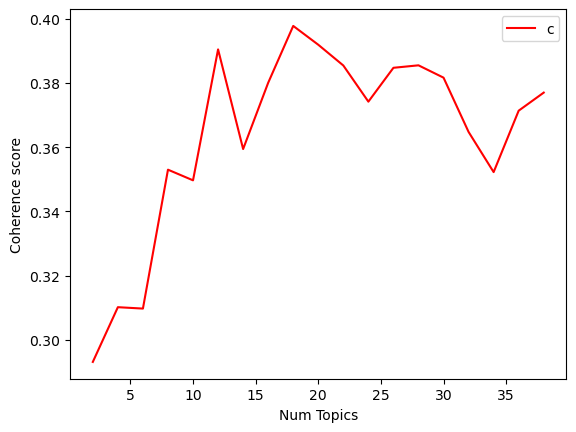

In [217]:
# Show graph
limit=40; start=2; step=2;
x = range(start, limit, step)
plt.plot(x, coherence_values,color='red')
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [215]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.2931
Num Topics = 4  has Coherence Value of 0.3102
Num Topics = 6  has Coherence Value of 0.3097
Num Topics = 8  has Coherence Value of 0.353
Num Topics = 10  has Coherence Value of 0.3497
Num Topics = 12  has Coherence Value of 0.3905
Num Topics = 14  has Coherence Value of 0.3594
Num Topics = 16  has Coherence Value of 0.3801
Num Topics = 18  has Coherence Value of 0.3978
Num Topics = 20  has Coherence Value of 0.3919
Num Topics = 22  has Coherence Value of 0.3854
Num Topics = 24  has Coherence Value of 0.3742
Num Topics = 26  has Coherence Value of 0.3847
Num Topics = 28  has Coherence Value of 0.3855
Num Topics = 30  has Coherence Value of 0.3817
Num Topics = 32  has Coherence Value of 0.3648
Num Topics = 34  has Coherence Value of 0.3522
Num Topics = 36  has Coherence Value of 0.3714
Num Topics = 38  has Coherence Value of 0.377


In [224]:
# Select the model and print the topics
optimal_model = model_list[5]
model_topics = optimal_model.show_topics(formatted=False)
pprint(optimal_model.print_topics(num_words=10)) #

[(0,
  '0.020*"transport" + 0.014*"trader" + 0.013*"mobility" + '
  '0.011*"transnational" + 0.009*"market" + 0.009*"network" + '
  '0.007*"diasporic" + 0.006*"social" + 0.006*"economic" + '
  '0.006*"institutional"'),
 (1,
  '0.015*"growth" + 0.014*"business" + 0.012*"training" + 0.012*"skill" + '
  '0.010*"performance" + 0.009*"level" + 0.009*"use" + 0.009*"respondent" + '
  '0.008*"factor" + 0.008*"table"'),
 (2,
  '0.010*"education" + 0.010*"variable" + 0.010*"result" + 0.009*"factor" + '
  '0.007*"model" + 0.007*"role" + 0.007*"effect" + 0.007*"use" + '
  '0.007*"difference" + 0.006*"social"'),
 (3,
  '0.124*"water" + 0.013*"space" + 0.010*"independence" + 0.009*"wukro" + '
  '0.007*"hotel" + 0.006*"alonsoalmeida" + 0.004*"marginality" + '
  '0.003*"negotiate" + 0.003*"subjectivity" + 0.003*"scarcity"'),
 (4,
  '0.000*"social" + 0.000*"role" + 0.000*"support" + 0.000*"family" + '
  '0.000*"resource" + 0.000*"need" + 0.000*"innovativeness" + 0.000*"market" + '
  '0.000*"economic" +

### Finding the dominant topic in each sentence

In [366]:
#import tuples
def format_topics_sentences(ldamodel=optimal_model, corpus=corpus, texts=texts):
    # Init output
    final = []
    # Get main topic in each document
    for i, row_list in enumerate(optimal_model[corpus]):
        row = row_list[0] if optimal_model.per_word_topics else row_list
        row = sorted(row, key=lambda x: (x[1]),reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            #if j == 0:  # => dominant topic
            wp = optimal_model.show_topic(topic_num,topn=20)
            topic_keywords = ", ".join([word for word, prop in wp])
            lists1 = int(topic_num), round(prop_topic,4),topic_keywords
            final.append(lists1)
#            else:
#                break
    sent_topics_df = pd.DataFrame(final, columns=['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords'])
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df,contents], axis=1,ignore_index=True)

    return(sent_topics_df)

df_topic_sents_keywords = format_topics_sentences(ldamodel=optimal_model, corpus=corpus, texts=texts)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']

# Show
df_dominant_topic.head(10)

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,11,0.6337,,"[seek, examine, social, proﬁle, region, order,..."
1,1,9,0.1851,,"[signiﬁcant, contribution, sustain, socioecono..."
2,2,1,0.1116,,"[paper, examine, challenge, face, development,..."
3,3,2,0.0696,,"[onal, obscurity, acknowledge, contribution, r..."
4,4,9,0.6469,,"[select, design_methodology, approach, theoret..."
5,5,11,0.3400,,"[factor, underpin, decision, design_methodolog..."
6,6,1,0.0130,,"[aim, explore, sustainable_practice, undertake..."
7,7,9,0.7940,,"[explore, growth, barrier, experience, sample,..."
8,8,11,0.1459,,"[economic, growth, bring, new, evidence, case,..."
9,9,2,0.0307,,"[investigate, assess, accessibility, different..."


In [375]:
print(df_dominant_topic.Dominant_Topic.value_counts())
df_dominant_topic['Text'] = df_dominant_topic['Text'].apply(str)
df_dominant_topic.loc[:,'TEXT_BODY'] = df_dominant_topic['Text'].astype(str).apply(lambda x:[process.extract(x, AFRICA.astype(str).TEXT_BODY, limit=1,scorer=fuzz.token_set_ratio)][0][0][0])
TOPIC_ARTICLE = df_dominant_topic.groupby(['Text','Dominant_Topic']).agg({'Topic_Perc_Contrib':'max',
                                                                          'Keywords':'first',
                                                       'Document_No':'first','TEXT_BODY':'first'}).reset_index()
MERGED_RESULT = pd.merge(TOPIC_ARTICLE[~(TOPIC_ARTICLE.Text.duplicated())], 
                 AFRICA, on='TEXT_BODY')
MERGED_RESULT.groupby('Dominant_Topic').agg(lambda x: x.unique().tolist()).to_csv('TOPIC_INFO.csv')

Dominant_Topic
11    128
9     111
1      85
2      80
10     28
0       5
5       4
8       3
7       2
3       2
Name: count, dtype: int64


KeyError: 'TEXT_BODY'

In [361]:
#.groupby('Dominant_Topic', as_index=False)['B'].agg(list)
MERGED_RESULT.groupby('Dominant_Topic').agg(lambda x: x.unique().tolist()).to_csv('TOPIC_INFO.csv')
MERGED_RESULT[['Keywords','Dominant_Topic','Topic_Perc_Contrib',
               'CLEAN_AUTHOR','COUNTRY_STUDY']].groupby('Dominant_Topic').agg(
    lambda x: x.unique().tolist())

,Keywords,Topic_Perc_Contrib,CLEAN_AUTHOR,COUNTRY_STUDY
Dominant_Topic,,,,
0,"[transport, trader, mobility, transnational, m...","[0.3330000042915344, 0.2070000022649765]","['Otoo, Miriam', 'Ibro, Germaine', 'Fulton, Jo...","['NIGER', 'MOROCCO']"
1,"[growth, business, training, skill, performanc...","[0.012799999676644802, 0.18459999561309814, 0....","['Kimuli, Saadat Nakyejwe Lubowa', 'Sendawula,...","['UGANDA', 'MOROCCO', 'GHANA', 'TANZANIA', 'BO..."
2,"[education, variable, result, factor, model, r...","[0.17020000517368317, 0.17239999771118164, 0.0...","['Semkunde, Mohamed A.', 'Elly, Tumsifu', 'Cha...","['TANZANIA', 'GHANA', 'IMMIGRANT', 'SOUTH AFRI..."
5,"[service, adoption, awareness, efficiency, tec...",[0.019200000911951065],"['Halberstadt, Jantje', 'Spiegler, Anna B.']",['SOUTH AFRICA']
7,"[ome, medium, daily_nation, ﬁsherie, portray, ...","[0.05779999867081642, 0.09929999709129333]","['Madichie, Nnamdi', 'Brijlal, Pradeep', 'Brij...","['NIGERIA', 'SOUTH AFRICA']"
9,"[family, role, work, support, challenge, start...","[0.6949999928474426, 0.28929999470710754, 0.14...","['Stanley, Liz', 'Dampier, Helen', 'Quagrainie...","['SOUTH AFRICA', 'GHANA', 'TANZANIA', 'DEVELOP..."
10,"[identity, mobile_phone, practice, gendere, po...","[0.012900000438094139, 0.012799999676644802, 0...","['Ama, Njoku O.', 'Mangadi, Kagiso T.', 'Ama, ...","['BOTSWANA', 'GHANA', <NA>, 'DEVELOPING COUNTR..."
11,"[social, loan, sector, work, economic, group, ...","[0.3926999866962433, 0.41269999742507935, 0.49...","['Owalla, Beldina', 'Al Ghafri, Aziza', 'Makan...","['KENYA', 'NIGERIA', 'GHANA', 'SOUTH AFRICA', ..."


In [206]:
# Group top 5 sentences under each topic
sent_topics_sorteddf_mallet = pd.DataFrame()

sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                             grp.sort_values(['Perc_Contribution'], ascending=[0]).head(1)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Text"]

# Show
sent_topics_sorteddf_mallet.head()

,Topic_Num,Topic_Perc_Contrib,Keywords,Text
0,1,0.8238,"growth, business, training, skill, performance...","[ne, empirical, paper, measure, effectiveness,..."
1,2,0.8941,"education, variable, result, factor, model, ro...","[school, leadership, corresponding_author, ren..."
2,9,0.9982,"family, role, work, support, challenge, start,...","[mainly, focus, nuclear, family, neglect, type..."
3,10,0.6439,"identity, mobile_phone, practice, gendere, pos...","[analysis, life, story, time, require, various..."
4,11,0.9998,"social, loan, sector, work, economic, group, a...","[cite, article, response, crisis, journal, sus..."


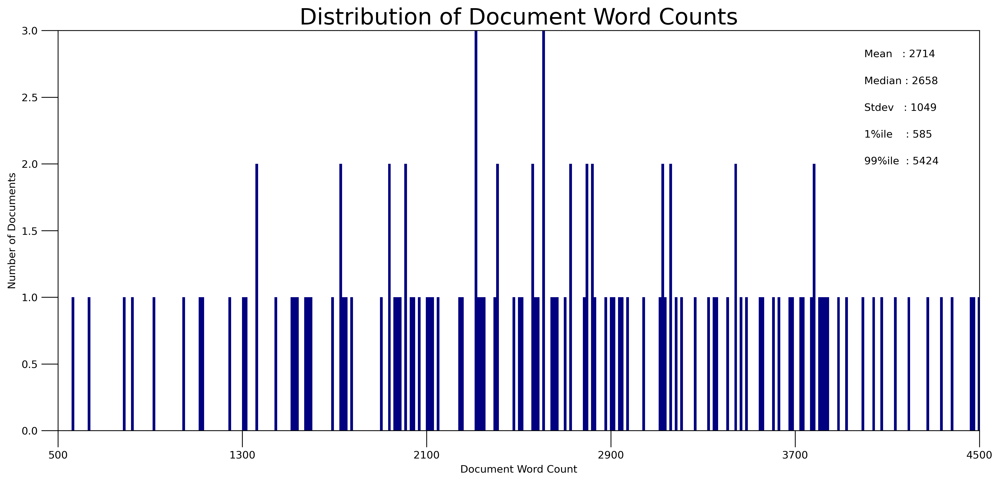

In [222]:
doc_lens = [len(d) for d in df_dominant_topic.Text]

# Plot
plt.figure(figsize=(16,7), dpi=300)
plt.hist(doc_lens, bins = 500, color='navy')
plt.text(4000, 2.8, "Mean   : " + str(round(np.mean(doc_lens))))
plt.text(4000,  2.6, "Median : " + str(round(np.median(doc_lens))))
plt.text(4000,  2.4, "Stdev   : " + str(round(np.std(doc_lens))))
plt.text(4000,  2.2, "1%ile    : " + str(round(np.quantile(doc_lens, q=0.01))))
plt.text(4000,  2.0, "99%ile  : " + str(round(np.quantile(doc_lens, q=0.99))))

plt.gca().set(xlim=(500, 4500),ylim=(0, 3), ylabel='Number of Documents', xlabel='Document Word Count')
plt.tick_params(size=16)
plt.xticks(np.linspace(500,4500,6))
plt.title('Distribution of Document Word Counts', fontdict=dict(size=22))
plt.show()

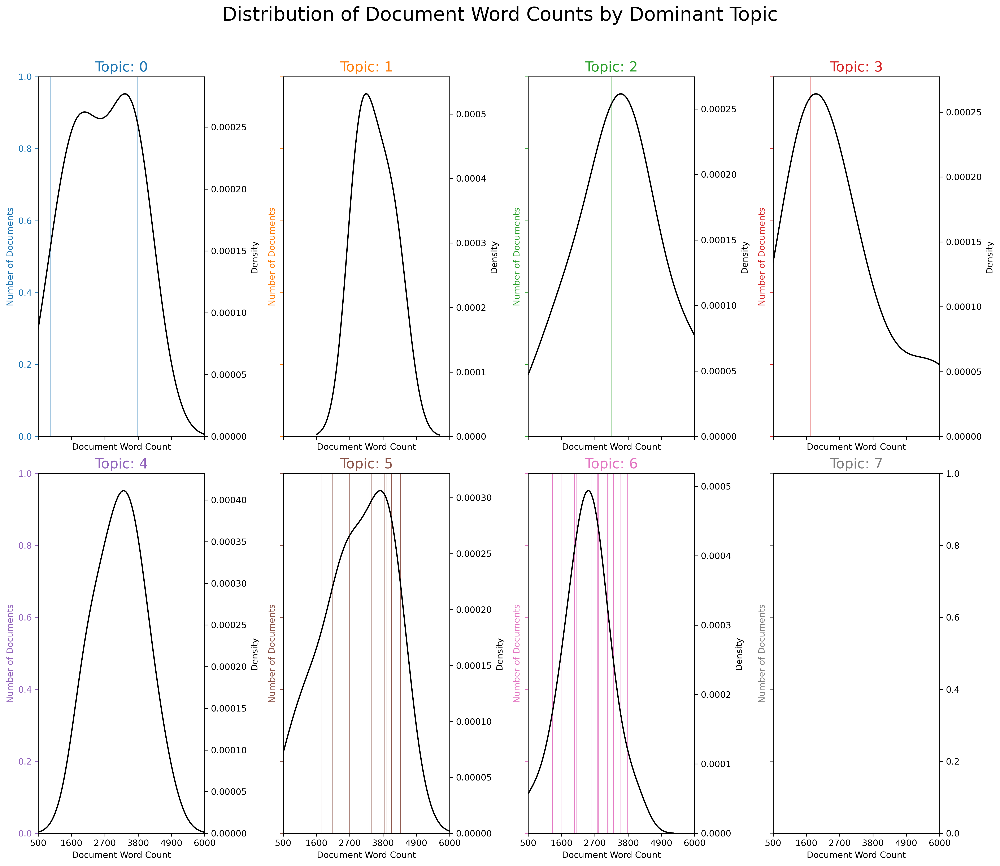

In [225]:
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

fig, axes = plt.subplots(2,4,figsize=(16,14), dpi=300, sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):    
    df_dominant_topic_sub = df_dominant_topic.loc[df_dominant_topic.Dominant_Topic == i, :]
    doc_lens = [len(d) for d in df_dominant_topic_sub.Text]
    ax.hist(doc_lens, bins = 1000, color=cols[i])
    ax.tick_params(axis='y', labelcolor=cols[i], color=cols[i])
    sns.kdeplot(doc_lens, color="black", fill=False, ax=ax.twinx())
    ax.set(xlim=(500, 6000), xlabel='Document Word Count',ylim=(0, 1))
    ax.set_ylabel('Number of Documents', color=cols[i])
    ax.set_title('Topic: '+str(i), fontdict=dict(size=16, color=cols[i]))

fig.tight_layout()
fig.subplots_adjust(top=0.90)
plt.xticks(np.linspace(500,6000,6))
fig.suptitle('Distribution of Document Word Counts by Dominant Topic', fontsize=22)
plt.show()

IndexError: list index out of range

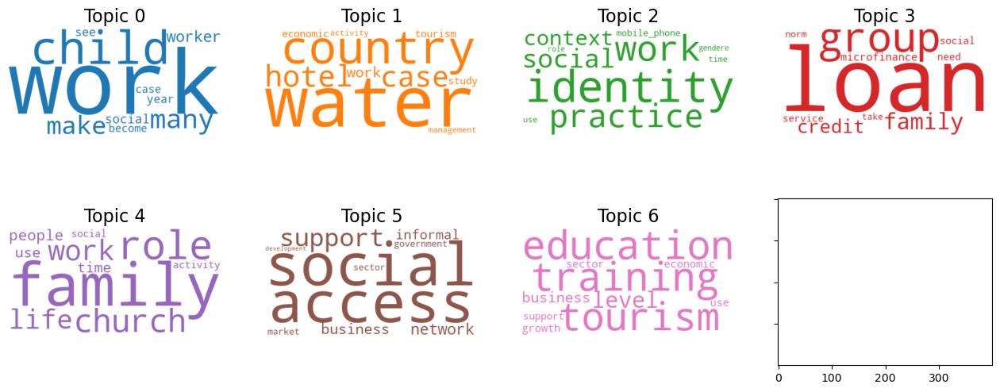

In [226]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                   max_font_size=150, random_state=130,
                  #width=2500,
                  #height=1800,
                  #max_words=10,
                  colormap='Dark2',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = optimal_model.show_topics(formatted=False)

fig, axes = plt.subplots(2, 4, figsize=(16,6), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud,interpolation='bilinear')
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

C:\Users\admin\AppData\Local\Temp\ipykernel_7732\2321020713.py:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')


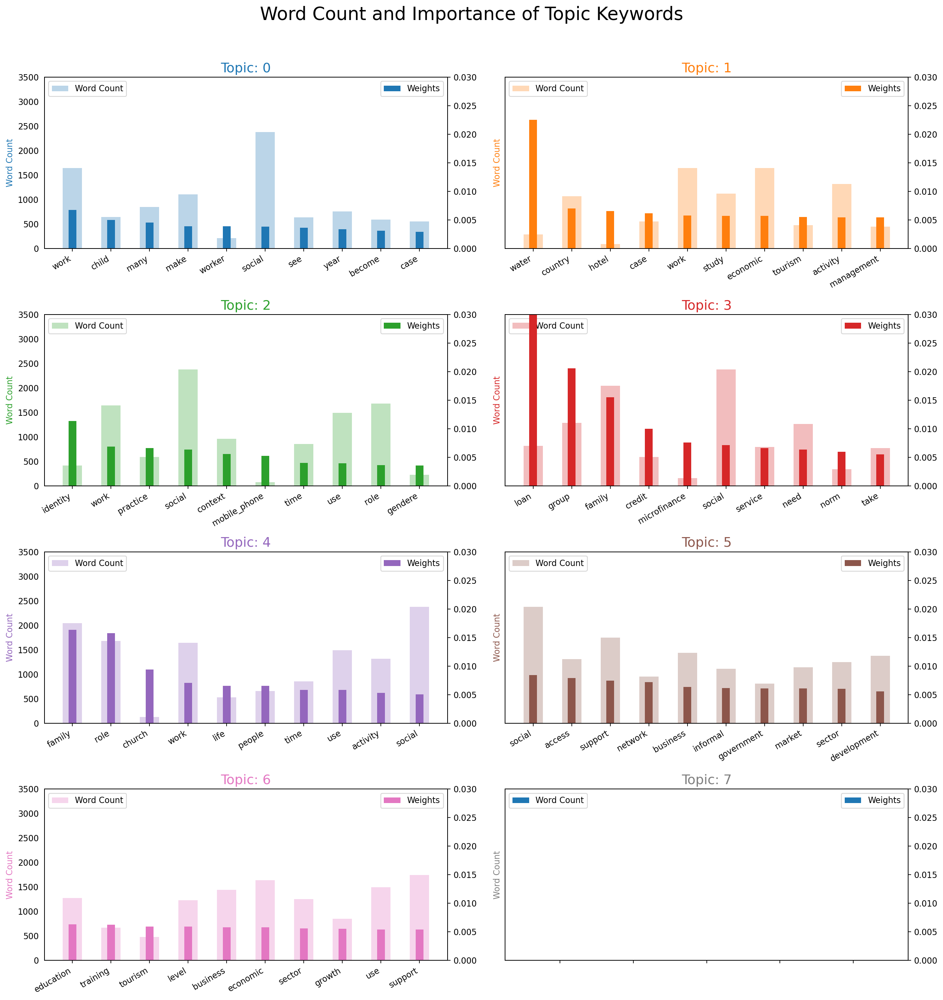

In [227]:
from collections import Counter
topics = optimal_model.show_topics(formatted=False)
data_flat = [w for w_list in texts for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(4,2, figsize=(16,16), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 3500)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.show()

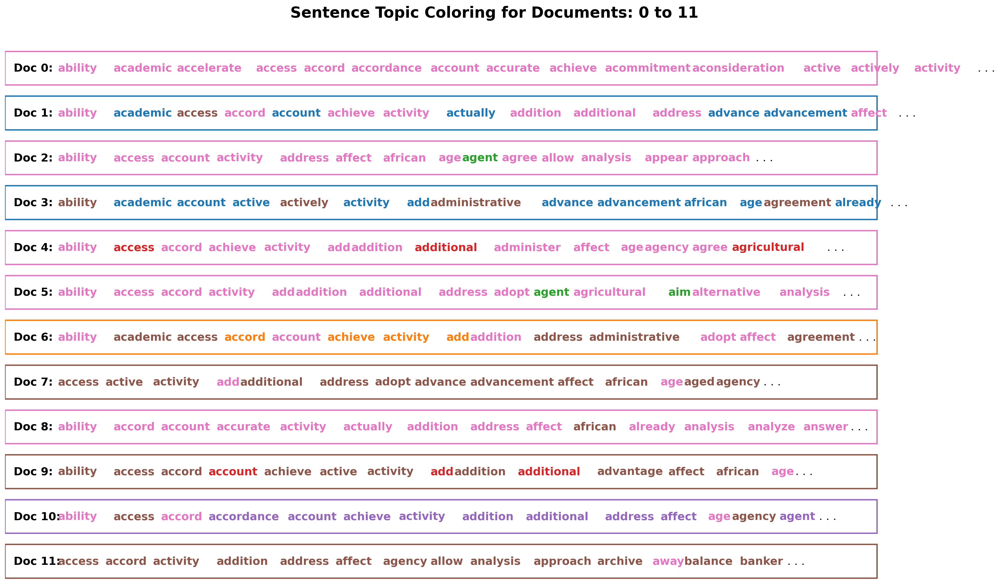

In [228]:
from matplotlib.patches import Rectangle

def sentences_chart(lda_model=optimal_model, corpus=corpus, start = 0, end = 13):
    corp = corpus[start:end]
    mycolors = [color for name, color in mcolors.TABLEAU_COLORS.items()]

    fig, axes = plt.subplots(end-start, 1, figsize=(20, (end-start)*0.95), dpi=160)       
    axes[0].axis('off')
    for i, ax in enumerate(axes):
        if i > 0:
            corp_cur = corp[i-1] 
            topic_percs, wordid_topics, wordid_phivalues = optimal_model[corp_cur]
            word_dominanttopic = [(optimal_model.id2word[wd], topic[0]) for wd, topic in wordid_topics]    
            ax.text(0.01, 0.5, "Doc " + str(i-1) + ": ", verticalalignment='center',
                    fontsize=16, color='black', transform=ax.transAxes, fontweight=700)

            # Draw Rectange
            topic_percs_sorted = sorted(topic_percs, key=lambda x: (x[1]), reverse=True)
            ax.add_patch(Rectangle((0.0, 0.05), 0.99, 0.90, fill=None, alpha=1, 
                                   color=mycolors[topic_percs_sorted[0][0]], linewidth=2))

            word_pos = 0.06
            for j, (word, topics) in enumerate(word_dominanttopic):
                if j < 14:
                    ax.text(word_pos, 0.5, word,
                            horizontalalignment='left',
                            verticalalignment='center',
                            fontsize=16, color=mycolors[topics],
                            transform=ax.transAxes, fontweight=700)
                    word_pos += .009 * len(word)  # to move the word for the next iter
                    ax.axis('off')
            ax.text(word_pos, 0.5, '. . .',
                    horizontalalignment='left',
                    verticalalignment='center',
                    fontsize=16, color='black',
                    transform=ax.transAxes)       

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.suptitle('Sentence Topic Coloring for Documents: ' + str(start) + ' to ' + str(end-2), fontsize=22, y=0.95, fontweight=700)
    plt.tight_layout()
    plt.show()

sentences_chart()

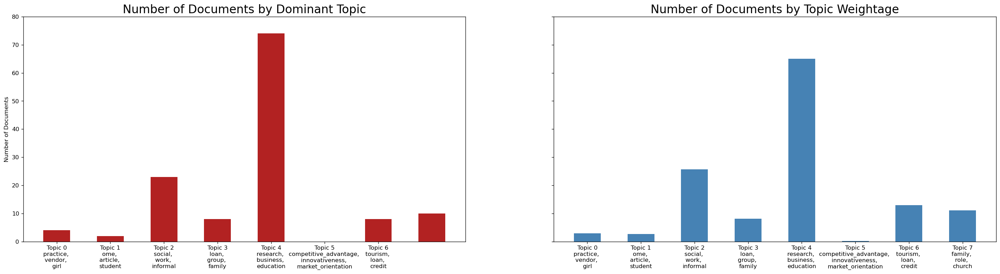

In [239]:
def topics_per_document(model, corpus, start=0, end=1):
    corpus_sel = corpus[start:end]
    dominant_topics = []
    topic_percentages = []
    for i, corp in enumerate(corpus_sel):
        topic_percs, wordid_topics, wordid_phivalues = model[corp]
        dominant_topic = sorted(topic_percs, key = lambda x: x[1], reverse=True)[0][0]
        dominant_topics.append((i, dominant_topic))
        topic_percentages.append(topic_percs)
    return(dominant_topics, topic_percentages)

dominant_topics, topic_percentages = topics_per_document(model=optimal_model, corpus=corpus, end=-1)            

# Distribution of Dominant Topics in Each Document
df = pd.DataFrame(dominant_topics, columns=['Document_Id', 'Dominant_Topic'])
dominant_topic_in_each_doc = df.groupby('Dominant_Topic').size()
df_dominant_topic_in_each_doc = dominant_topic_in_each_doc.to_frame(name='count').reset_index()

# Total Topic Distribution by actual weight
topic_weightage_by_doc = pd.DataFrame([dict(t) for t in topic_percentages])
df_topic_weightage_by_doc = topic_weightage_by_doc.sum().to_frame(name='count').reset_index()

# Top 3 Keywords for each Topic
topic_top3words = [(i, topic) for i, topics in optimal_model.show_topics(formatted=False) 
                                 for j, (topic, wt) in enumerate(topics) if j < 3]

df_top3words_stacked = pd.DataFrame(topic_top3words, columns=['topic_id', 'words'])
df_top3words = df_top3words_stacked.groupby('topic_id').agg(', \n'.join)
df_top3words.reset_index(level=0,inplace=True)
#Let’s make two plots:
#The number of documents for each topic by assigning the document to the topic that has the most weight in that document.
#The number of documents for each topic by by summing up the actual weight contribution of each topic to respective documents.
from matplotlib.ticker import FuncFormatter

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 7), dpi=120, sharey=True)

# Topic Distribution by Dominant Topics
ax1.bar(x='Dominant_Topic', height='count', data=df_dominant_topic_in_each_doc, width=.5, color='firebrick')
ax1.set_xticks(range(df_dominant_topic_in_each_doc.Dominant_Topic.unique().__len__()))
tick_formatter = FuncFormatter(lambda x, pos: 'Topic ' + str(x)+ '\n' + df_top3words.loc[df_top3words.topic_id==x, 'words'].values[0])
ax1.xaxis.set_major_formatter(tick_formatter)
ax1.set_title('Number of Documents by Dominant Topic', fontdict=dict(size=20))
ax1.set_ylabel('Number of Documents')
ax1.set_ylim(0, 80)

# Topic Distribution by Topic Weights
ax2.bar(x='index', height='count', data=df_topic_weightage_by_doc, width=.5, color='steelblue')
ax2.set_xticks(range(df_topic_weightage_by_doc.index.unique().__len__()))
ax2.xaxis.set_major_formatter(tick_formatter)
ax2.set_title('Number of Documents by Topic Weightage', fontdict=dict(size=20))

plt.show()

In [229]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(optimal_model, corpus, dictionary=optimal_model.id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
6     -0.056144  0.032795       1        1  39.354078
5     -0.067069  0.036804       2        1  24.134947
0      0.013630 -0.023106       3        1  11.631203
2      0.054983  0.133444       4        1   8.662730
4      0.158592 -0.051814       5        1   7.043831
3     -0.042078 -0.122395       6        1   6.495679
1     -0.061914 -0.005729       7        1   2.677532, topic_info=          Term         Freq        Total Category  logprob  loglift
539       loan   932.000000   932.000000  Default  30.0000  30.0000
358     family  1902.000000  1902.000000  Default  29.0000  29.0000
416      group  1270.000000  1270.000000  Default  28.0000  28.0000
11029  tourism   882.000000   882.000000  Default  27.0000  27.0000
817       role  1323.000000  1323.000000  Default  26.0000  26.0000
...        ...          ...          ...      ...      ...      ...
358     family    40.290300  1902.121591   Topic7  -5.4574  -0.2343
553       make    35.061778  1073.897305   Topic7  -5.5964   0.1983
526      level    33.659456  1212.715755   Topic7  -5.6372   0.0360
817       role    31.649424  1323.370590   Topic7  -5.6988  -0.1129
778     regard    27.367947   502.837490   Topic7  -5.8441   0.7094

[574 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
3         1  0.273238   access
3         2  0.533011   access
3         3  0.036432   access
3         4  0.046728   access
3         5  0.004752   access
...     ...       ...      ...
7559      6  0.904139  ﬁsherie
4761      1  0.191372   ﬂuence
4761      2  0.067543   ﬂuence
4761      4  0.337715   ﬂuence
4761      5  0.399630   ﬂuence

[1603 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 6, 1, 3, 5, 4, 2])

In [231]:
# Number of Documents for Each Topic
topic_counts = df_topic_sents_keywords['Dominant_Topic'].value_counts()

# Percentage of Documents for Each Topic
topic_contribution = round(topic_counts/topic_counts.sum(), 4)

# Topic Number and Keywords
topic_num_keywords = df_topic_sents_keywords[['Dominant_Topic', 'Topic_Keywords']]

# Concatenate Column wise
df_dominant_topics = pd.concat([topic_num_keywords, topic_counts, topic_contribution], axis=1)

# Change Column names
df_dominant_topics.columns = ['Dominant_Topic', 'Topic_Keywords', 'Num_Documents', 'Perc_Documents']

# Show
df_dominant_topics.head(9)

,Dominant_Topic,Topic_Keywords,Num_Documents,Perc_Documents
0,6,"education, training, tourism, level, business,...",14.0,0.1077
1,0,"work, child, many, make, worker, social, see, ...",4.0,0.0308
2,6,"education, training, tourism, level, business,...",8.0,0.0615
3,0,"work, child, many, make, worker, social, see, ...",7.0,0.0538
4,6,"education, training, tourism, level, business,...",9.0,0.0692
5,6,"education, training, tourism, level, business,...",30.0,0.2308
6,1,"water, country, hotel, case, work, study, econ...",58.0,0.4462
7,5,"social, access, support, network, business, in...",NaN,NaN
8,6,"education, training, tourism, level, business,...",NaN,NaN


In [246]:
df_dominant_topics[0:7]
topic_num_keywords[['Dominant_Topic', 'Topic_Keywords']].Dominant_Topic.value_counts()
for index, articles in enumerate(data_T.columns[0:12]):
    wc.generate(AFRICA_NLTK.TEXT_BODY[articles])
    
    plt.subplot(3,4, index+1)
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.title(full_names[index])
plt.show()

Dominant_Topic
6    58
5    30
0    14
4     9
2     8
3     7
1     4
Name: count, dtype: int64

In [235]:
print(len(data_words))
print(len(data_lemmatized))
print(len(id2word))
print(len(texts))
print(len(corpus))
print(len([[(id2word[id], freq) for id, freq in cp] for cp in corpus[:130]]))
print('LDA Model with 20 topics',type(lda_model))
print(len(doc_lda))
print(len(model_list))
print(len(coherence_values))
print('LDA Model with 8 topics',type(optimal_model))
print(len(model_topics))
print(len(df_dominant_topic))
print(len(df_topic_sents_keywords))
print(len(sent_topics_sorteddf_mallet))

130
130
19903
130
130
130
LDA Model with 20 topics <class 'gensim.models.ldamodel.LdaModel'>
130
8
8
LDA Model with 8 topics <class 'gensim.models.ldamodel.LdaModel'>
7
130
130
7


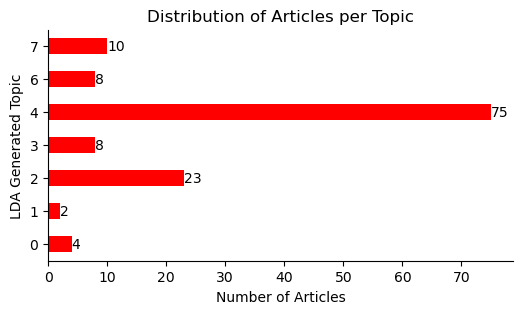

In [255]:
#df_dominant_topic.groupby('Dominant_Topic').size().plot.bar()
ax = df_dominant_topic.groupby('Dominant_Topic').size(
).plot(kind='barh',title='Distribution of Articles per Topic',xlabel='Number of Articles',
                    ylabel='LDA Generated Topic',color='r',figsize=(6,3))
for c in ax.containers:
    # set the bar label
    ax.bar_label(c, fmt='%.0f', label_type='edge')

#ax.legend(title='count per journal', bbox_to_anchor=(1, 1.02), loc='upper left')

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.show()

In [ ]:
new_text = ""
for w in words:
    if len(w) > 1:
        new_text = new_text + " " + w

### GENESIM YOUTUBE

In [249]:
#vectorizer = CountVectorizer()
AFRICA_NLTK = AFRICA.copy()
AFRICA_NLTK['Name'] = AFRICA_NLTK[
    'xml|records|record|dates|year'].astype(str).str.cat(AFRICA_NLTK['CLEAN_AUTHOR'].str[:20], sep=' ')
#AFRICA_NLTK['Name'] = AFRICA_NLTK['Name'].str[:12]
AFRICA_NLTK = AFRICA_NLTK.set_index('Name')
cv = CountVectorizer(stop_words='english')
data_cv = cv.fit_transform(AFRICA_NLTK.TEXT_BODY)
data_dtm = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names_out())
data_dtm.index = AFRICA_NLTK.index
data_dtm

,aachen,aaker,aalborg,aalten,aangebied,aangesien,aardt,aardtand,aardtthrough,aargentina,...,ﬃcients,ﬃcking,ﬃcult,ﬃculties,ﬃculty,ﬃeld,ﬃrmation,ﬃrming,ﬃﬃﬃﬃﬃ,ﬄuent
Name,,,,,,,,,,,,,,,,,,,,,
"2011 'Halkias, Daphne', '",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2004 'Woldie, Atsede', 'A",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2010 'Mordi, Chima', 'Sim",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2011 'Madichie, Nnamdi O.",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2011 'Oluranti Ogunrinola,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"2007 'Botha, Melodi', 'Ni",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"1987 'Erwee, Ronel'",0,0,0,0,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2019 'Steyn, Renier', 'de",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [245]:
#vectorizer = CountVectorizer()
AFRICA_NLTK = AFRICA.copy()
AFRICA_NLTK['Name'] = AFRICA_NLTK[
    'xml|records|record|dates|year'].astype(str).str.cat(AFRICA_NLTK['CLEAN_AUTHOR'].str[:20], sep=' ')
#AFRICA_NLTK['Name'] = AFRICA_NLTK['Name'].str[:12]
AFRICA_NLTK = AFRICA_NLTK.set_index('Name')
cv = TfidfVectorizer(stop_words='english')
data_cv = cv.fit_transform(AFRICA_NLTK.TEXT_BODY)
data_dtm = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names_out())
data_dtm.index = AFRICA_NLTK.index
data_dtm

,aachen,aaker,aalborg,aalten,aangebied,aangesien,aardt,aardtand,aardtthrough,aargentina,...,ﬃcients,ﬃcking,ﬃcult,ﬃculties,ﬃculty,ﬃeld,ﬃrmation,ﬃrming,ﬃﬃﬃﬃﬃ,ﬄuent
Name,,,,,,,,,,,,,,,,,,,,,
"2011 'Halkias, Daphne', '",0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"2004 'Woldie, Atsede', 'A",0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"2010 'Mordi, Chima', 'Sim",0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"2011 'Madichie, Nnamdi O.",0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2011 'Oluranti Ogunrinola,0.0,0.0,0.015517,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"2007 'Botha, Melodi', 'Ni",0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"1987 'Erwee, Ronel'",0.0,0.0,0.000000,0.0,0.012083,0.012083,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"2019 'Steyn, Renier', 'de",0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [250]:
data_T = data_dtm.transpose()
data_T.head(5)

Name,"2011 'Halkias, Daphne', '","2004 'Woldie, Atsede', 'A","2010 'Mordi, Chima', 'Sim","2011 'Madichie, Nnamdi O.",2011 'Oluranti Ogunrinola,"2011 'Singh, Satwinder',","2022 'Kimuli, Saadat Naky","2022 'Shava, Herring', 'C","2015 'Okah-Efogo, Françoi","2015 'Lindvert, Marta', '",...,"1975 'Bujra, Janet M.'","2016 'Ibrahim, Seriki Ido","2008 'Ojong, Vivian Besem","2001 'Mahadea, D.'",1989 'Ronel Erwee',"2007 'Botha, Melodi', 'Ni","1987 'Erwee, Ronel'","2019 'Steyn, Renier', 'de","1995 'Schutte, JL', 'Bosh","2010 'Singh, Satwinder',"
aachen,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aaker,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aalborg,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aalten,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aangebied,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [251]:
top_dict = {}
for i in data_T.columns:
    top = data_T[i].sort_values(ascending=False).head(10)
    top_dict[i] = list(zip(top.index, top.values))
top_dict

{"2011 'Halkias, Daphne', '": [('women', 100),
  ('percent', 57),
  ('entrepreneurs', 56),
  ('nigeria', 51),
  ('business', 48),
  ('development', 34),
  ('family', 26),
  ('economic', 26),
  ('entrepreneurship', 24),
  ('research', 23)],
 "2004 'Woldie, Atsede', 'A": [('women', 155),
  ('business', 79),
  ('men', 47),
  ('nigeria', 37),
  ('cent', 35),
  ('woman', 29),
  ('respondents', 25),
  ('nigerian', 20),
  ('female', 20),
  ('discrimination', 18)],
 "2010 'Mordi, Chima', 'Sim": [('women', 41),
  ('business', 39),
  ('entrepreneurs', 39),
  ('female', 38),
  ('challenges', 32),
  ('cent', 30),
  ('nigeria', 26),
  ('lack', 25),
  ('family', 17),
  ('gender', 16)],
 "2011 'Madichie, Nnamdi O.": [('women', 77),
  ('woman', 37),
  ('nigerian', 32),
  ('faseke', 30),
  ('nigeria', 18),
  ('dr', 13),
  ('men', 12),
  ('king', 11),
  ('time', 10),
  ('book', 8)],
 "2011 'Oluranti Ogunrinola": [('social', 73),
  ('capital', 69),
  ('informal', 30),
  ('rural', 27),
  ('variables', 27)

In [252]:
for articles, top_words in top_dict.items():
    print(articles)
    print(', '.join([word for word, count in top_words[0:14]]))
    print('--------')

2011 'Halkias, Daphne', '
women, percent, entrepreneurs, nigeria, business, development, family, economic, entrepreneurship, research
--------
2004 'Woldie, Atsede', 'A
women, business, men, nigeria, cent, woman, respondents, nigerian, female, discrimination
--------
2010 'Mordi, Chima', 'Sim
women, business, entrepreneurs, female, challenges, cent, nigeria, lack, family, gender
--------
2011 'Madichie, Nnamdi O.
women, woman, nigerian, faseke, nigeria, dr, men, king, time, book
--------
2011 'Oluranti Ogunrinola
social, capital, informal, rural, variables, credit, cent, microentrepreneurs, women, earnings
--------
2011 'Singh, Satwinder', 
women, entrepreneurs, nigeria, female, decision, entrepreneur, choice, rational, business, model
--------
2022 'Kimuli, Saadat Naky
business, practices, women, sustainable, businesses, entrepreneurship, owners, market, social, environmental
--------
2022 'Shava, Herring', 'C
women, entrepreneurs, subsistence, sector, study, business, participant, re

In [253]:
from collections import Counter
words = []
for articles in data_T.columns:
    top = [word for [word, count] in top_dict[articles]]
    for t in top:
        words.append(t)
words

['women',
 'percent',
 'entrepreneurs',
 'nigeria',
 'business',
 'development',
 'family',
 'economic',
 'entrepreneurship',
 'research',
 'women',
 'business',
 'men',
 'nigeria',
 'cent',
 'woman',
 'respondents',
 'nigerian',
 'female',
 'discrimination',
 'women',
 'business',
 'entrepreneurs',
 'female',
 'challenges',
 'cent',
 'nigeria',
 'lack',
 'family',
 'gender',
 'women',
 'woman',
 'nigerian',
 'faseke',
 'nigeria',
 'dr',
 'men',
 'king',
 'time',
 'book',
 'social',
 'capital',
 'informal',
 'rural',
 'variables',
 'credit',
 'cent',
 'microentrepreneurs',
 'women',
 'earnings',
 'women',
 'entrepreneurs',
 'nigeria',
 'female',
 'decision',
 'entrepreneur',
 'choice',
 'rational',
 'business',
 'model',
 'business',
 'practices',
 'women',
 'sustainable',
 'businesses',
 'entrepreneurship',
 'owners',
 'market',
 'social',
 'environmental',
 'women',
 'entrepreneurs',
 'subsistence',
 'sector',
 'study',
 'business',
 'participant',
 'research',
 'growth',
 'issues',


In [254]:
Counter(words).most_common()

[('women', 119),
 ('entrepreneurs', 86),
 ('business', 73),
 ('entrepreneurship', 50),
 ('female', 33),
 ('social', 33),
 ('entrepreneurial', 26),
 ('study', 21),
 ('gender', 20),
 ('economic', 19),
 ('family', 18),
 ('research', 16),
 ('development', 15),
 ('businesses', 14),
 ('men', 13),
 ('informal', 13),
 ('african', 12),
 ('nigeria', 11),
 ('sector', 11),
 ('support', 11),
 ('south', 11),
 ('education', 11),
 ('cent', 10),
 ('africa', 10),
 ('ghana', 9),
 ('challenges', 8),
 ('capital', 8),
 ('rural', 8),
 ('success', 7),
 ('access', 7),
 ('woman', 6),
 ('credit', 6),
 ('growth', 6),
 ('formal', 6),
 ('countries', 6),
 ('training', 6),
 ('roles', 6),
 ('factors', 6),
 ('government', 6),
 ('networks', 6),
 ('tourism', 6),
 ('market', 5),
 ('botswana', 5),
 ('uganda', 5),
 ('role', 5),
 ('performance', 5),
 ('work', 5),
 ('participants', 5),
 ('small', 5),
 ('respondents', 4),
 ('lack', 4),
 ('entrepreneur', 4),
 ('loans', 4),
 ('studies', 4),
 ('group', 4),
 ('context', 4),
 ('res

In [272]:
add_stop_words = [word for word, count in Counter(words).most_common() if count >49]
add_stop_words.extend(['from', 'subject', 're', 'edu', 'use','also','business','entrepreneur','research','study',
                       'woman', 'entrepreneurs', 'women','P','S','C','faseke','cent','percent','dr','turkish','vol',
                       'nigeria','nigerian','ethiopia','oman','dr','cameroon','female','men','th','ome','ngozi',
                       'calli','gendere','gender','ome','ﬀect','okello','cogent','download','co','ghana','e'])
#add_stop_words

In [273]:
stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)
#AFRICA_NLTK = AFRICA_NLTK.set_index('Name')
cv = CountVectorizer(stop_words=list(stop_words))
data_cv = cv.fit_transform(AFRICA_NLTK.TEXT_BODY)
data_stop = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names_out())
data_stop.index = AFRICA_NLTK.index

In [274]:
wc = WordCloud(stopwords=stop_words, background_color='white',colormap='Dark2',
              max_font_size=150, random_state=130)

In [275]:
plt.rcParams['figure.figsize'] = [16,6]
full_names = data_T.columns[0:12].to_list()

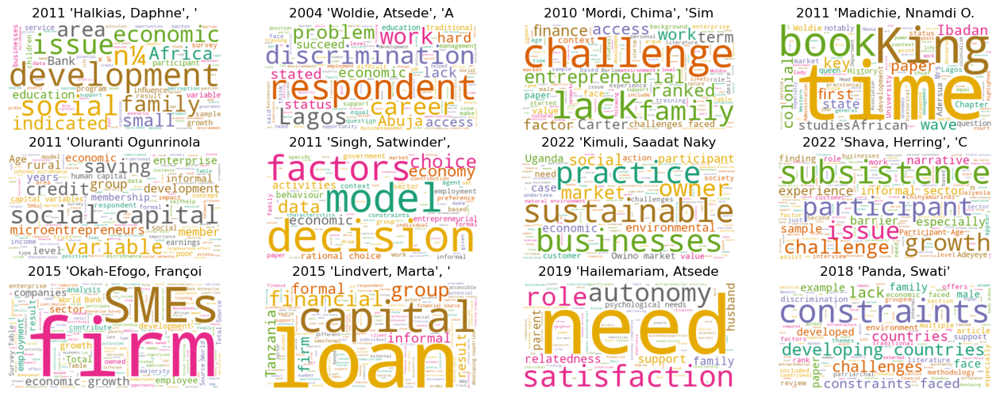

In [276]:
for index, articles in enumerate(data_T.columns[0:12]):
    wc.generate(AFRICA_NLTK.TEXT_BODY[articles])
    
    plt.subplot(3,4, index+1)
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.title(full_names[index])
plt.show()

In [277]:
unique_list = []
for articles in data_T.columns:
    uniques = data_T[articles].to_numpy().nonzero()[0].size
    unique_list.append(uniques)
data_words = pd.DataFrame(list(zip(data_T.columns.to_list(),unique_list)), columns=['articles','unique_words'])
data_unique_sort = data_words.sort_values(by='unique_words')
data_unique_sort
total_list = []
for articles in data_T.columns:
    totals = sum(data_T[articles])
    total_list.append(totals)
data_words['total_words'] = total_list 
data_vpmsort = data_words.sort_values(by='total_words')

In [278]:
Counter(words).most_common()
data_bad_words = data_T.transpose()[['family','informal']]
data_profanity = pd.concat([data_bad_words.family, data_bad_words.informal],axis=1)
data_profanity.columns = ['f_word', 's_word']
data_profanity

,f_word,s_word
Name,,
"2011 'Halkias, Daphne', '",26,3
"2004 'Woldie, Atsede', 'A",7,5
"2010 'Mordi, Chima', 'Sim",17,3
"2011 'Madichie, Nnamdi O.",0,2
2011 'Oluranti Ogunrinola,1,30
...,...,...
"2007 'Botha, Melodi', 'Ni",0,0
"1987 'Erwee, Ronel'",24,1
"2019 'Steyn, Renier', 'de",0,1


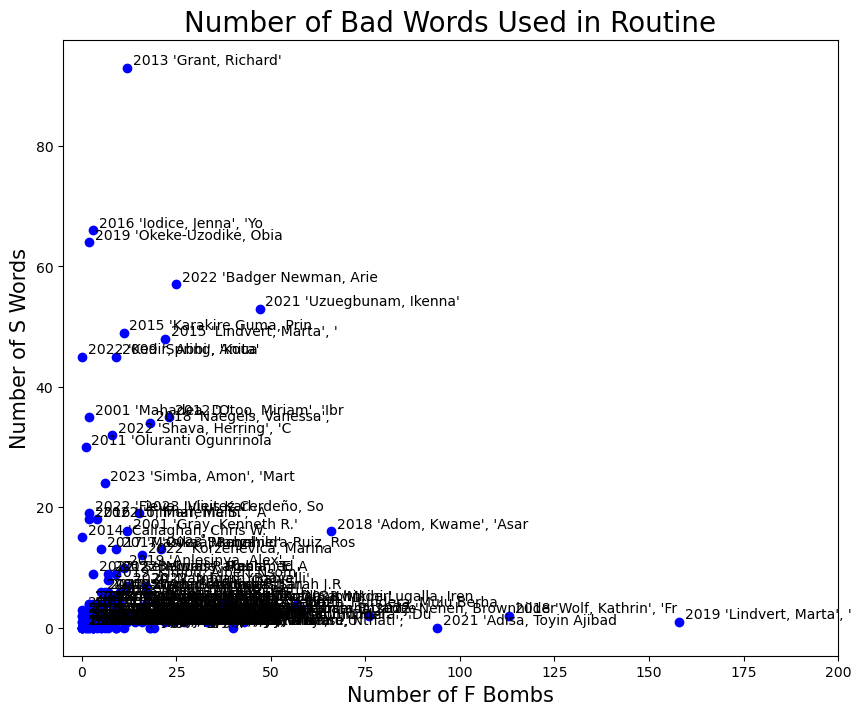

In [279]:
# Let's create a scatter plot of our findings
plt.rcParams['figure.figsize'] = [10, 8]

for i, articles in enumerate(data_profanity.index):
    x = data_profanity.f_word.loc[articles]
    y = data_profanity.s_word.loc[articles]
    plt.scatter(x, y, color='blue')
    plt.text(x+1.5, y+0.5, data_T.columns.to_list()[i], fontsize=10)
    plt.xlim(-5, 200) 
    
plt.title('Number of Bad Words Used in Routine', fontsize=20)
plt.xlabel('Number of F Bombs', fontsize=15)
plt.ylabel('Number of S Words', fontsize=15)

plt.show()

In [263]:
tdm = data_stop.transpose()
tdm.head()

Name,"2011 'Halkias, Daphne', '","2004 'Woldie, Atsede', 'A","2010 'Mordi, Chima', 'Sim","2011 'Madichie, Nnamdi O.",2011 'Oluranti Ogunrinola,"2011 'Singh, Satwinder',","2022 'Kimuli, Saadat Naky","2022 'Shava, Herring', 'C","2015 'Okah-Efogo, Françoi","2015 'Lindvert, Marta', '",...,"1975 'Bujra, Janet M.'","2016 'Ibrahim, Seriki Ido","2008 'Ojong, Vivian Besem","2001 'Mahadea, D.'",1989 'Ronel Erwee',"2007 'Botha, Melodi', 'Ni","1987 'Erwee, Ronel'","2019 'Steyn, Renier', 'de","1995 'Schutte, JL', 'Bosh","2010 'Singh, Satwinder',"
aachen,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aaker,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aalborg,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aalten,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aangebied,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [264]:
sparse_counts = scipy.sparse.csr_matrix(tdm)
corpus = matutils.Sparse2Corpus(sparse_counts)

In [265]:
#cv
id2word = dict((v,k) for k, v in cv.vocabulary_.items())

In [266]:
lda = models.LdaModel(corpus=corpus, id2word=id2word, num_topics=10, passes=10)
lda.print_topics()

[(0,
  '0.006*"social" + 0.005*"study" + 0.004*"family" + 0.004*"entrepreneurial" + 0.003*"work" + 0.003*"rural" + 0.003*"development" + 0.003*"time" + 0.003*"businesses" + 0.003*"gender"'),
 (1,
  '0.008*"loan" + 0.007*"credit" + 0.006*"group" + 0.005*"loans" + 0.005*"family" + 0.005*"development" + 0.004*"access" + 0.004*"social" + 0.004*"mobile" + 0.004*"rural"'),
 (2,
  '0.006*"entrepreneurial" + 0.006*"tourism" + 0.005*"gender" + 0.004*"social" + 0.004*"economic" + 0.004*"sector" + 0.003*"capital" + 0.003*"studies" + 0.003*"study" + 0.003*"informal"'),
 (3,
  '0.008*"training" + 0.007*"performance" + 0.005*"eo" + 0.005*"social" + 0.005*"african" + 0.005*"economic" + 0.004*"development" + 0.004*"study" + 0.004*"entrepreneurial" + 0.004*"factors"'),
 (4,
  '0.011*"entrepreneurial" + 0.006*"gender" + 0.005*"study" + 0.005*"development" + 0.004*"access" + 0.004*"orientation" + 0.004*"support" + 0.004*"transport" + 0.003*"social" + 0.003*"informal"'),
 (5,
  '0.008*"support" + 0.007*"s

In [80]:
#import nltk
#nltk.download('punkt')
from nltk import word_tokenize, pos_tag
def nouns(text):
    '''given a string of text, tokenize the text and pull out only the nouns.'''
    is_noun = lambda pos: pos[:2] == "NN"
    tokenized = word_tokenize(text)
    all_nouns = [word for [word, pos] in pos_tag(tokenized) if is_noun(pos)]
    return ' '.join(all_nouns)

In [81]:
data_nouns = pd.DataFrame(AFRICA_NLTK.TEXT_BODY.apply(nouns))
data_nouns

,TEXT_BODY
Name,
"2011 'Halkias, Daphne', '",study business proﬁles women entrepreneurs reg...
"2004 'Woldie, Atsede', 'A",t Nigeria contribution women wellbeing familie...
"2010 'Mordi, Chima', 'Sim",paper challenges face development business con...
"2011 'Madichie, Nnamdi O.",obscurity contributions academics market conte...
2011 'Oluranti Ogunrinola,entrepreneurs ruralcommunities Ogun State Nige...
...,...
"2007 'Botha, Melodi', 'Ni",women paper effectiveness respondents training...
"1987 'Erwee, Ronel'",rch t focus entrepreneur A lifecycle model car...
"2019 'Steyn, Renier', 'de",esburg South Africa Graduate School Business L...


In [82]:
stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)

cvn = CountVectorizer(stop_words=list(stop_words))
data_cvn = cvn.fit_transform(data_nouns.TEXT_BODY)
data_dtmn = pd.DataFrame(data_cvn.toarray(), columns=cvn.get_feature_names_out())
data_dtmn.index = data_nouns.index
data_dtmn

,aachen,aaker,aalborg,aalten,aangesien,aardt,aardtand,aardtthrough,aawes,aawesdefined,...,ﬃciency,ﬃcient,ﬃcients,ﬃcking,ﬃcult,ﬃculties,ﬃculty,ﬃrmation,ﬃﬃﬃﬃﬃ,ﬄuent
Name,,,,,,,,,,,,,,,,,,,,,
"2011 'Halkias, Daphne', '",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2004 'Woldie, Atsede', 'A",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2010 'Mordi, Chima', 'Sim",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2011 'Madichie, Nnamdi O.",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2011 'Oluranti Ogunrinola,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"2007 'Botha, Melodi', 'Ni",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"1987 'Erwee, Ronel'",0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2019 'Steyn, Renier', 'de",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [83]:
corpusn = matutils.Sparse2Corpus(scipy.sparse.csr_matrix(data_dtmn.transpose()))
id2wordn = dict((v,k) for k, v in cvn.vocabulary_.items())
ldan = models.LdaModel(corpus=corpusn, id2word=id2wordn, num_topics=10, passes=10)
ldan.print_topics()

[(0,
  '0.019*"tourism" + 0.010*"research" + 0.008*"businesses" + 0.007*"africa" + 0.007*"skills" + 0.007*"sector" + 0.007*"support" + 0.007*"community" + 0.006*"study" + 0.006*"growth"'),
 (1,
  '0.011*"development" + 0.008*"study" + 0.008*"credit" + 0.007*"businesses" + 0.007*"market" + 0.005*"training" + 0.005*"access" + 0.005*"ghana" + 0.005*"research" + 0.005*"group"'),
 (2,
  '0.012*"networks" + 0.010*"orientation" + 0.009*"gender" + 0.007*"market" + 0.006*"dairy" + 0.006*"resilience" + 0.006*"development" + 0.005*"agripreneurs" + 0.005*"sector" + 0.004*"traders"'),
 (3,
  '0.008*"gender" + 0.006*"transport" + 0.006*"omes" + 0.006*"development" + 0.005*"identity" + 0.005*"identities" + 0.005*"media" + 0.005*"study" + 0.005*"loan" + 0.004*"services"'),
 (4,
  '0.012*"role" + 0.010*"family" + 0.008*"work" + 0.008*"study" + 0.008*"roles" + 0.008*"performance" + 0.006*"success" + 0.006*"research" + 0.006*"gender" + 0.006*"support"'),
 (5,
  '0.011*"study" + 0.009*"research" + 0.009*"

In [84]:
#import nltk
#nltk.download('punkt')
from nltk import word_tokenize, pos_tag
def nouns_adj(text):
    '''given a string of text, tokenize the text and pull out only the nouns and adjectives.'''
    is_noun_adj = lambda pos: pos[:2] == "NN" or pos[:2] == "JJ"
    tokenized = word_tokenize(text)
    nouns_adj = [word for [word, pos] in pos_tag(tokenized) if is_noun_adj(pos)]
    return ' '.join(nouns_adj)
data_nouns_adj = pd.DataFrame(AFRICA_NLTK.TEXT_BODY.apply(nouns_adj))
data_nouns_adj

,TEXT_BODY
Name,
"2011 'Halkias, Daphne', '",study business social proﬁles women entreprene...
"2004 'Woldie, Atsede', 'A",t Nigeria past signiﬁcant contribution women s...
"2010 'Mordi, Chima', 'Sim",paper challenges entrepreneurs face developmen...
"2011 'Madichie, Nnamdi O.",ational obscurity contributions reputable acad...
2011 'Oluranti Ogunrinola,entrepreneurs selected ruralcommunities Ogun S...
...,...
"2007 'Botha, Melodi', 'Ni",women empirical paper effectiveness respondent...
"1987 'Erwee, Ronel'",rch t career focus male entrepreneur A lifecyc...
"2019 'Steyn, Renier', 'de",esburg South Africa Graduate School Business L...


In [85]:
cvna = CountVectorizer(stop_words=list(stop_words))
data_cvna = cvna.fit_transform(data_nouns_adj.TEXT_BODY)
data_dtmna = pd.DataFrame(data_cvna.toarray(), columns=cvna.get_feature_names_out())
data_dtmna.index = data_nouns_adj.index
data_dtmna

,aachen,aaker,aalborg,aalten,aangesien,aardt,aardtand,aardtthrough,aawes,aawesdefined,...,ﬃciency,ﬃcient,ﬃcients,ﬃcking,ﬃcult,ﬃculties,ﬃculty,ﬃrmation,ﬃﬃﬃﬃﬃ,ﬄuent
Name,,,,,,,,,,,,,,,,,,,,,
"2011 'Halkias, Daphne', '",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2004 'Woldie, Atsede', 'A",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2010 'Mordi, Chima', 'Sim",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2011 'Madichie, Nnamdi O.",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2011 'Oluranti Ogunrinola,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"2007 'Botha, Melodi', 'Ni",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"1987 'Erwee, Ronel'",0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"2019 'Steyn, Renier', 'de",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [86]:
corpusna = matutils.Sparse2Corpus(scipy.sparse.csr_matrix(data_dtmna.transpose()))
id2wordna = dict((v,k) for k, v in cvna.vocabulary_.items())
ldana = models.LdaModel(corpus=corpusna, id2word=id2wordna, num_topics=4, passes=10)
ldana.print_topics()

[(0,
  '0.007*"social" + 0.006*"capital" + 0.006*"informal" + 0.005*"market" + 0.004*"entrepreneurial" + 0.004*"businesses" + 0.004*"formal" + 0.004*"african" + 0.004*"economic" + 0.004*"education"'),
 (1,
  '0.008*"entrepreneurial" + 0.007*"research" + 0.005*"gender" + 0.005*"social" + 0.005*"study" + 0.005*"family" + 0.004*"success" + 0.004*"mobile" + 0.004*"studies" + 0.004*"work"'),
 (2,
  '0.007*"study" + 0.007*"entrepreneurial" + 0.007*"family" + 0.006*"economic" + 0.006*"social" + 0.006*"research" + 0.005*"role" + 0.005*"development" + 0.005*"education" + 0.005*"businesses"'),
 (3,
  '0.010*"social" + 0.008*"entrepreneurial" + 0.007*"development" + 0.006*"study" + 0.005*"gender" + 0.005*"group" + 0.005*"family" + 0.004*"research" + 0.004*"access" + 0.004*"loan"')]

In [87]:
corpus_transformed = ldana[corpusna]
list(zip([a for [(a,b)] in list(corpus_transformed)], list(data_dtmna.index)))

ValueError: too many values to unpack (expected 1)

In [ ]:
list(corpus_transformed)
list(data_dtmna.index)
data1 = {"topic_group1": [], "topic_group2": [], "Documnets": []}
for a,*b in list(corpus_transformed):
    for c in list(data_dtmna.index):
        data_all1 = max(a),b,c
        for key, value in zip(data1.keys(), data_all1):
            data1[key].append(value)

df = pd.DataFrame(data1)

In [ ]:
#vectorizer = CountVectorizer()
AFRICA_NLTK = AFRICA.copy()
AFRICA_NLTK['Name'] = AFRICA_NLTK[
    'xml|records|record|dates|year'].astype(str).str.cat(AFRICA_NLTK['CLEAN_AUTHOR'].str[:20], sep=' ')
#AFRICA_NLTK['Name'] = AFRICA_NLTK['Name'].str[:12]
AFRICA_NLTK = AFRICA_NLTK.set_index('Name')
cv = CountVectorizer(stop_words='english')
data_cv = cv.fit_transform(AFRICA_NLTK.TEXT_BODY)
data_dtm = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names_out())
data_dtm.index = AFRICA_NLTK.index
data_dtm

data_T = data_dtm.transpose()
data_T.head(5)

top_dict = {}
for i in data_T.columns:
    top = data_T[i].sort_values(ascending=False).head(10)
    top_dict[i] = list(zip(top.index, top.values))
top_dict
from collections import Counter
words = []
for articles in data_T.columns:
    top = [word for [word, count] in top_dict[articles]]
    for t in top:
        words.append(t)
words
Counter(words).most_common()
add_stop_words = [word for word, count in Counter(words).most_common() if count >49]
add_stop_words.extend(['from', 'subject', 're', 'edu', 'use','also','business','entrepreneur','research','study',
                       'woman', 'entrepreneurs', 'women','P','S','C','faseke','cent','percent','dr','turkish','vol',
                       'nigeria','nigerian','ethiopia','oman','dr','cameroon','female','men','th','ome','ngozi',
                       'calli','gendere','gender','ome','ﬀect','okello','cogent','download','co','ghana','e'])
#add_stop_words
stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)
#AFRICA_NLTK = AFRICA_NLTK.set_index('Name')
cv = CountVectorizer(stop_words=list(stop_words))
data_cv = cv.fit_transform(AFRICA_NLTK.TEXT_BODY)
data_stop = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names_out())
data_stop.index = AFRICA_NLTK.index
tdm = data_stop.transpose()
tdm.head()
sparse_counts = scipy.sparse.csr_matrix(tdm)
corpus = matutils.Sparse2Corpus(sparse_counts)
#cv
id2word = dict((v,k) for k, v in cv.vocabulary_.items())
lda = models.LdaModel(corpus=corpus, id2word=id2word, num_topics=10, passes=10)
lda.print_topics()
#import nltk
#nltk.download('punkt')
from nltk import word_tokenize, pos_tag
def nouns(text):
    '''given a string of text, tokenize the text and pull out only the nouns.'''
    is_noun = lambda pos: pos[:2] == "NN"
    tokenized = word_tokenize(text)
    all_nouns = [word for [word, pos] in pos_tag(tokenized) if is_noun(pos)]
    return ' '.join(all_nouns)
data_nouns = pd.DataFrame(AFRICA_NLTK.TEXT_BODY.apply(nouns))
data_nouns
stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)

cvn = CountVectorizer(stop_words=list(stop_words))
data_cvn = cvn.fit_transform(data_nouns.TEXT_BODY)
data_dtmn = pd.DataFrame(data_cvn.toarray(), columns=cvn.get_feature_names_out())
data_dtmn.index = data_nouns.index
data_dtmn
corpusn = matutils.Sparse2Corpus(scipy.sparse.csr_matrix(data_dtmn.transpose()))
id2wordn = dict((v,k) for k, v in cvn.vocabulary_.items())
ldan = models.LdaModel(corpus=corpusn, id2word=id2wordn, num_topics=10, passes=10)
ldan.print_topics()
#import nltk
#nltk.download('punkt')
from nltk import word_tokenize, pos_tag
def nouns_adj(text):
    '''given a string of text, tokenize the text and pull out only the nouns and adjectives.'''
    is_noun_adj = lambda pos: pos[:2] == "NN" or pos[:2] == "JJ"
    tokenized = word_tokenize(text)
    nouns_adj = [word for [word, pos] in pos_tag(tokenized) if is_noun_adj(pos)]
    return ' '.join(nouns_adj)
data_nouns_adj = pd.DataFrame(AFRICA_NLTK.TEXT_BODY.apply(nouns_adj))
data_nouns_adj
cvna = CountVectorizer(stop_words=list(stop_words))
data_cvna = cvna.fit_transform(data_nouns_adj.TEXT_BODY)
data_dtmna = pd.DataFrame(data_cvna.toarray(), columns=cvna.get_feature_names_out())
data_dtmna.index = data_nouns_adj.index
data_dtmna
corpusna = matutils.Sparse2Corpus(scipy.sparse.csr_matrix(data_dtmna.transpose()))
id2wordna = dict((v,k) for k, v in cvna.vocabulary_.items())
ldana = models.LdaModel(corpus=corpusna, id2word=id2wordna, num_topics=4, passes=10)
ldana.print_topics()
corpus_transformed = ldana[corpusna]
list(zip([a for [(a,b)] in list(corpus_transformed)], list(data_dtmna.index)))
list(corpus_transformed)
list(data_dtmna.index)
data1 = {"topic_group1": [], "topic_group2": [], "Documnets": []}
for a,*b in list(corpus_transformed):
    for c in list(data_dtmna.index):
        data_all1 = max(a),b,c
        for key, value in zip(data1.keys(), data_all1):
            data1[key].append(value)

df = pd.DataFrame(data1)

In [ ]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.ldamodel.LdaModel(corpus=corpus,id2word=id2word,num_topics=num_topics, random_state=100,update_every=1,chunksize=100, passes=10, alpha='auto', per_word_topics=True)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [383]:
AFRICA[AFRICA['COUNTRY_STUDY'].astype(str) == "'SOUTH AFRICA'"]
AFRICA['TEXT_BODY'][17]

'niversity of North Carolina at Greensboro Greensboro North Carolina Female entrepreneurs play an increasingly recognised role in countries overall wellbeing by contributing to job creation wealth family income and innovation This study identifies combinations of family support that enhance business performance most effectively Design methodology approach This study employs a fuzzyset qualitative comparative analysis fsQCA drawing on technology business owners to identify the family support configurations most conducive to high business performance Findings The results suggest that high levels of emotional and instrumental support are necessary for female technology entrepreneurs to achieve a high firm performance FP level when instrumental support at home is lacking As a comparison male technology entrepreneurs can still achieve a high level of FP when emotional and instrumental support for the business is low Originality value This research contributes to the body of knowledge on wom

In [325]:
#for i in data_T.columns:
#    print(data_T[i].sort_values().head(30))
data_T.loc[:,~data_T.columns.duplicated()]

Name,"2011 'Halkias, Daphne', '","2004 'Woldie, Atsede', 'A","2010 'Mordi, Chima', 'Sim","2011 'Madichie, Nnamdi O.",2011 'Oluranti Ogunrinola,"2011 'Singh, Satwinder',","2022 'Kimuli, Saadat Naky","2022 'Shava, Herring', 'C","2015 'Okah-Efogo, Françoi","2015 'Lindvert, Marta', '",...,"1975 'Bujra, Janet M.'","2016 'Ibrahim, Seriki Ido","2008 'Ojong, Vivian Besem","2001 'Mahadea, D.'",1989 'Ronel Erwee',"2007 'Botha, Melodi', 'Ni","1987 'Erwee, Ronel'","2019 'Steyn, Renier', 'de","1995 'Schutte, JL', 'Bosh","2010 'Singh, Satwinder',"
aachen,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aaker,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aalborg,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aalten,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aangebied,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ﬃeld,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ﬃrmation,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ﬃrming,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ﬃﬃﬃﬃﬃ,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [48]:
MENDLAY_ALL.loc[:,'MATCH_ABSTRACT'] = MENDLAY_ALL['xml|records|record|abstract'].astype(str).apply(lambda x:[process.extract(x, CORPUS_TOTAL['PAGE1'].astype(str), limit=1,scorer=fuzz.token_set_ratio)][0][0][0])

In [64]:
CORPUS_TOTAL['PAGE1'][0]#.columns
MENDLAY_ALL[['xml|records|record|urls|related-urls','xml|records|record|titles|title',
            'xml|records|record|keywords|keyword','xml|records|record|dates|year',
            'xml|records|record|contributors|authors','xml|records|record|abstract',
            'MATCH_ABSTRACT']].head(60)
#MENDLAY_ALL[MENDLAY_ALL['MATCH_ABSTRACT']==None]

,xml|records|record|urls|related-urls,xml|records|record|titles|title,xml|records|record|keywords|keyword,xml|records|record|dates|year,xml|records|record|contributors|authors,xml|records|record|abstract,MATCH_ABSTRACT
0,None,The global training deficit: The scarcity of f...,"[Economic growth, Entrepreneurialism, Professi...",2012,"{'author': 'Davis, Paul J.'}",Purpose: The purpose of this paper is to highl...,The global training deﬁcit: the scarcity\nof f...
1,{'url': 'NIGERIA'},Challenges facing women entrepreneurs in Nigeria,"[Africa, Entrepreneurs, Nigeria, Poverty, Women]",2011,"{'author': ['Halkias, Daphne', 'Nwajiuba, Chin...",Purpose: This study seeks to examine the busin...,Challenges facing women\nentrepreneurs in Nige...
2,None,From top management to entrepreneurship: Women...,"[Career development, Entrepreneurialism, Senio...",2011,"{'author': 'Knörr, Helena'}",Purpose: The purpose of this paper is to provi...,From top management to\nentrepreneurship: wome...
3,None,Gender differences in entrepreneurship: Equali...,"[Entrepreneurialism, Equal opportunities, Gend...",2010,"{'author': ['Malach Pines, Ayala', 'Lerner, Mi...","Purpose – In 2008, the world had undergone a g...","EDI\n29,2\n186\nEquality, Diversity and Inclus..."
4,None,"Professional insights women, business and the ...","[Entrepreneurialism, Gender, International eco...",2012,"{'author': 'Ahmad, Syed Zamberi'}",Purpose - Given the importance of legal parity...,"PROFESSIONAL INSIGHTS\nWomen, business and the..."
5,None,Women entrepreneurship in Mongolia: The role o...,"[Economic development, Entrepreneurship, Gende...",2013,"{'author': 'Aramand, Majid'}",Purpose - The purpose of this paper is to draw...,Women entrepreneurship in\nMongolia: the role ...
6,None,Women entrepreneurs in a developing economy,"[Developing countries, Economic growth, Entrep...",1999,"{'author': ['Hisrich, Robert D', 'Ayse, Sevgi'...",While research on women entrepreneurs is exten...,"Journal of\nManagementDevelopment18,2\n114\nTh..."
7,None,Counselling encounters between banks and entre...,"[Banks, Customer satisfaction, Entrepreneurs, ...",2005,"{'author': ['Björnsson, Berit', 'Abraha, Desal...","Purpose — To examine how customers, both men a...",Counselling encounters between\nbanks and entr...
8,None,"Now you see them, now you don't: Gender differ...","[Entrepreneurialism, Gender differences, Perce...",2008,"{'author': ['Malach-Pines, Ayala', 'Schwartz, ...","Purpose - While the numbers of, and research o...","Now you see them, now you don’t:\ngender diffe..."
9,None,Mentoring female entrepreneurs: A mentors' tra...,"[Greece, Mentoring, Mentors, Start-up entrepre...",2011,"{'author': 'Sarri, Katerina K.'}",Purpose: The purpose of this paper is to evalu...,PERSPECTIVE ON PRACTICE\nMentoring female entr...
